In [1]:
#DTW calculation

import pandas as pd
import numpy as np
import os
import glob 
import pickle
from math import *
import matplotlib.pyplot as plt
from scipy import stats
import seaborn as sns
from pylab import rcParams
from sklearn import metrics
from sklearn.model_selection import train_test_split
from scipy.ndimage import gaussian_filter
from scipy.fftpack import fft
from dtw import dtw
from numpy import array, zeros, argmin, inf, ndim
from scipy.spatial.distance import cdist
from sklearn.metrics.pairwise import manhattan_distances
from sklearn import svm
from sklearn.ensemble import RandomForestClassifier
from sklearn.cross_validation import cross_val_score
from sklearn.metrics import accuracy_score
# from quatrotate import qv_mult # this routine implements rotation via quaternion multiplication

%matplotlib inline

/home/vicky/anaconda3/lib/python3.6/site-packages/sklearn/cross_validation.py:41: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.
  "This module will be removed in 0.20.", DeprecationWarning)


In [2]:
def find_contiguous_colors(colors):
    # finds the continuous segments of colors and returns those segments
    segs = []
    curr_seg = []
    prev_color = ''
    for c in colors:
        if c == prev_color or prev_color == '':
            curr_seg.append(c)
        else:
            segs.append(curr_seg)
            curr_seg = []
            curr_seg.append(c)
        prev_color = c
    segs.append(curr_seg) # the final one
    return segs
 
def plot_multicolored_lines(x,y,colors):
    segments = find_contiguous_colors(colors)
    plt.figure(figsize=(20,4))
    start= 0
    for seg in segments:
        end = start + len(seg)
        l, = plt.gca().plot(x[start-1:end+1],y[start-1:end+1],lw=2,c=seg[0]) 
        start = end

In [3]:
# Function to map the colors as a list from the input list of x variables
def color_mapping(lst):
    cols=[]
    colors = {'ST':'blue', 'LT':'red','RT':'green'}
    for l in lst:
        cols.append(colors[l])      
    return cols

In [4]:
def GaussianFilter(df, window_length):
    df1 = df
    
    df1['AX'] = gaussian_filter(df['AX'], window_length)
    df1['AY'] = gaussian_filter(df['AY'], window_length)
    df1['AZ'] = gaussian_filter(df['AZ'], window_length)

    df1['GX'] = gaussian_filter(df['GX'], window_length)
    df1['GY'] = gaussian_filter(df['GY'], window_length)
    df1['GZ'] = gaussian_filter(df['GZ'], window_length)
    
    df1['AX1'] = gaussian_filter(df['AX1'], window_length)
    df1['AY1'] = gaussian_filter(df['AY1'], window_length)
    df1['AZ1'] = gaussian_filter(df['AZ1'], window_length)

    df1['GX1'] = gaussian_filter(df['GX1'], window_length)
    df1['GY1'] = gaussian_filter(df['GY1'], window_length)
    df1['GZ1'] = gaussian_filter(df['GZ1'], window_length)
    
    df1['mAcc'] = gaussian_filter(df['mAcc'], window_length)
    df1['mGyro'] = gaussian_filter(df['mGyro'], window_length)
    return df1

In [5]:
def Amplitude(df, input_features, out_feature):
    df[out_feature] = (df[input_features[0]]**2 + df[input_features[1]]**2  + df[input_features[2]]**2)**(1/2)
  
    

In [6]:
   
 
def ComplementaryFilter(accData, gyrData,pitch, roll):
    AS= 8192
    GS= .65536
    M_PI= 3.14159265359   
    dt= 0.02  # 10 ms sample rate! 

    pitch += (gyrData[0] / GS) * dt   #// Ang 10 ms le around the X-axis
    roll -=  (gyrData[1] / GS) * dt   # // Angle around the Y-axis
 
    forceMagnitudeApprox = abs(accData[0]) + abs(accData[1]) + abs(accData[2])
    
    if (forceMagnitudeApprox > 8192 and forceMagnitudeApprox < 32768):
        pitchAcc = atan(accData[1]/ accData[2]) * 180 / M_PI
        pitch = pitch * 0.98 + pitchAcc * 0.02
        rollAcc = atan(accData[0]/ accData[2]) * 180 / M_PI
        roll = roll * 0.98 + rollAcc * 0.02
        
    return pitch, roll
    

In [7]:
def Yaw_Roll_Pitch(df):
    roll  = []
    pitch = []
    yaw   = []
    xx = []
    yy = []
    zz = []
    roll2=0
    pitch2=0
    for i in range(len(df)):
        x = df['AX'][i]
        y = df['AY'][i]
        z = df['AZ'][i]
        
        gx = df['GX'][i]
        gy = df['GY'][i]
        gz = df['GZ'][i]
        
        roll1 = atan((y/z))*57.3
        pitch1= atan((-x/(y*y + z*z)**(1/2)))*57.3
        yaw1  = atan((z/((x*x + z*z)**(1/2))))*57.3
        
#         xxx = atan(x/((y*y + z*z)**(1/2)))*57.3
#         yyy = atan(y/((x*x + z*z)**(1/2)))*57.3
#         zzz = atan(((y*y + x*x)**(1/2))/z)*57.3
        
        roll2, pitch2 = ComplementaryFilter([x,y,z],[gx,gy,gz],roll2, pitch2)
        
        roll.append(roll1)
        pitch.append(pitch1)
        yaw.append(yaw1)
        
        xx.append(roll2*57.3)
        yy.append(pitch2*57.3)
    
    df['orientX'] = pitch
    df['orientY'] = roll
    df['orientZ'] = yaw
    
    df['xxx'] = xx
    df['yyy'] = yy
    

In [8]:
def getQuat(df):

        """ Given 3 orientation angles, compute the quaternion. """

        yaw   = df['orientZ'] / 2. * np.pi / 180
        roll  = df['orientX'] / 2. * np.pi / 180
        pitch = df['orientY'] / 2. * np.pi / 180

        w =  np.cos(roll) * np.cos(pitch) * np.cos(yaw) + \
                np.sin(roll) * np.sin(pitch) * np.sin(yaw)

        x =  np.sin(roll) * np.cos(pitch) * np.cos(yaw) - \
                np.cos(roll) * np.sin(pitch) * np.sin(yaw)

        y =  np.cos(roll) * np.sin(pitch) * np.cos(yaw) + \
                np.sin(roll) * np.cos(pitch) * np.sin(yaw)

        z =  np.cos(roll) * np.cos(pitch) * np.sin(yaw) - \
                np.sin(roll) * np.sin(pitch) * np.cos(yaw)

        return w, x, y, z

In [9]:
"""
Rotate a 3D vector using the axis-angle method (quaternions).
"""



def normalize(v, tolerance=0.00001):
    mag2 = sum(n * n for n in v)
    if abs(mag2 - 1.0) > tolerance:
        mag = np.sqrt(mag2)
        v = tuple(n / mag for n in v)
    return v

def q_mult(q1, q2):
    w1, x1, y1, z1 = q1
    w2, x2, y2, z2 = q2
    w = w1 * w2 - x1 * x2 - y1 * y2 - z1 * z2
    x = w1 * x2 + x1 * w2 + y1 * z2 - z1 * y2
    y = w1 * y2 + y1 * w2 + z1 * x2 - x1 * z2
    z = w1 * z2 + z1 * w2 + x1 * y2 - y1 * x2
    return w, x, y, z

def q_conjugate(q):
    w, x, y, z = q
    return (w, -x, -y, -z)

def qv_mult(q1, v1):
    q2 = (0.0,) + v1
    return q_mult(q_mult(q1, q2), q_conjugate(q1))[1:]

def axisangle_to_q(v, theta):
    v = normalize(v)
    x, y, z = v
    theta /= 2
    w = np.cos(theta)
    x = x * np.sin(theta)
    y = y * np.sin(theta)
    z = z * np.sin(theta)
    return w, x, y, z

def q_to_axisangle(q):
    w, v = q[0], q[1:]
    theta = np.acos(w) * 2.0
    return normalize(v), theta

In [10]:
def get_rotation(quatern, vector):
    rotaedvector = []
    for i in range(vector.shape[0]):
        rotaedvector.append(qv_mult(tuple(quatern[i,:]), tuple(vector[i,:])))
    return np.array(rotaedvector)

In [11]:
def rotate(df):
    features = ['A', 'G']
    quaternion = df[['quaternionW', 'quaternionX',
                     'quaternionY','quaternionZ']].values
    
    for f in features:
        xyzlist = [f + 'X', f + 'Y', f + 'Z']
        xyz = df[xyzlist].values
        xyz_rotated = get_rotation(quaternion, xyz)
        df[f + 'X1'] = xyz_rotated[:,0]
        df[f + 'Y1'] = xyz_rotated[:,1]
        df[f + 'Z1'] = xyz_rotated[:,2]
        

In [12]:
#generate frequency domain data from time domain data usinf Fast Fourier transformation

def FFT(df, input_features, output_features):
    
    for i in range(len(input_features)):
        reals = np.real(np.fft.rfft(df[input_features[i]]))
        imagn = np.imag(np.fft.rfft(df[input_features[i]]))

        complexs = [reals[0]]
        n = len(reals)
        if(n%2 == 0):
            complexs.append(imagn[0])
        for j in range(1, n-1):
            complexs.append(reals[j])
            complexs.append(imagn[j])
        if( len(df) > len(complexs)):
            complexs.append(reals[j])
        if( len(df) > len(complexs)):
            complexs.append(imagn[j])
            
        df[output_features[i]] = complexs
    return df

In [13]:
def segmentation(df, N_TIME_STEPS):
    
    N_FEATURES = 1
    step = 50
    segments = []
    labels = []
    for i in range(0, len(df) - N_TIME_STEPS, step):
        gx = df['GX1'].values[i: i + N_TIME_STEPS]
        gy = df['GY1'].values[i: i + N_TIME_STEPS]
        gz = df['GZ1'].values[i: i + N_TIME_STEPS]
        
        ax = df['AX1'].values[i: i + N_TIME_STEPS]
        ay = df['AY1'].values[i: i + N_TIME_STEPS]
        az = df['AZ1'].values[i: i + N_TIME_STEPS]
        
        fax = df['fAX'].values[i: i + N_TIME_STEPS]
        fay = df['fAY'].values[i: i + N_TIME_STEPS]
        faz = df['fAZ'].values[i: i + N_TIME_STEPS]
        
        ma = df['mAcc'].values[i: i + N_TIME_STEPS]
        mz = df['mGyro'].values[i: i + N_TIME_STEPS]
        label = "ST"
        segments.append([gx, gy, gz, ax, ay, az, ma, mz, fax, fay, faz])
#         labels = stats.mode(df['activity'][i: i + N_TIME_STEPS])[0][0]
        labels.append(label)
    return segments, labels

In [14]:
def DTWDistance(s1, s2, w):
    DTW={}

    w = max(w, abs(len(s1)-len(s2)))

    for i in range(-1,len(s1)):
        for j in range(-1,len(s2)):
            DTW[(i, j)] = float('inf')
    DTW[(-1, -1)] = 0

    for i in range(len(s1)):
        for j in range(max(0, i-w), min(len(s2), i+w)):
            dist= (s1[i]-s2[j])**2
            DTW[(i, j)] = dist + min(DTW[(i-1, j)],DTW[(i, j-1)], DTW[(i-1, j-1)])

    return (DTW[len(s1)-1, len(s2)-1])**(1/2)

In [15]:
def loss_for_segments(segments, comp, feature):
    loss =[]
    labels=[]
    length = len(segments)
    for i in range(length):
        x = segments[i][feature]        
        dist = DTWDistance(x, comp, 50)
#         print(i , '=>', dist)
        loss.append(dist)
    
    return loss

In [16]:
def DTWdistance(segments, ref):
    y = segments
    DTW_list = []
    for i in range(len(segments[1])):
        x = ref
#         print("calculating loss for feature ", i, "....")
        diff = loss_for_segments(y, x, i)
#         print("Done")
        DTW_list.append(diff)
    
    return DTW_list  

In [17]:
def Averaging(df, window_length):
    df1 = df
    
    for i,x in enumerate(df,1):
        
        
        df1['mmAX'] = mean(df['AX'][i, i + window_length] )
        df1['mmAY'] = mean(df['AY'][i, i + window_length] )
        df1['mmAZ'] = mean(df['AZ'][i, i + window_length] )
        
        
    mylist = [1, 2, 3, 4, 5, 6, 7]
    N = 3
    cumsum, moving_aves = [0], []

    for i, x in enumerate(mylist, 1):
        cumsum.append(cumsum[i-1] + x)
        if i>=N:
            moving_ave = (cumsum[i] - cumsum[i-N])/N
            #can do stuff with moving_ave here
            moving_aves.append(moving_ave)
        return df1

In [18]:
def data_preprocessing(df):
    
    #mean feature of 3-axis accelerometer data
    input_features = ['AX', 'AY', 'AZ']
    output_feature = 'mAcc'
    Amplitude(df, input_features, output_feature)
    
    #mean feature of 3-axis gyroscope data
    input_features = ['GX', 'GY', 'GZ']
    output_feature = 'mGyro'
    Amplitude(df, input_features, output_feature)
    
#     Re-Orientation of 3-axis acc. and gyro sensor data
    Yaw_Roll_Pitch(df)
    qw, qx, qy, qz = getQuat(df)
    df['quaternionW'] = qw
    df['quaternionX'] = qx
    df['quaternionY'] = qy
    df['quaternionZ'] = qz
    rotate(df)
#     apply gaussian filter with window size 10
    df = GaussianFilter(df, 30)
    
    #     averaging by taking mean of window size 10
#     df = Averaging(df, 10)

#     Frequency domain feature generation from time series accelerometer data
    input_features = ['AX1', 'AY1', 'AZ1']
    output_feature = ['fAX', 'fAY', 'fAZ']
    df = FFT(df, input_features, output_feature)
    
#     Frequency domain feature generation from time series gyroscope data
    input_features = ['AX1', 'AY1', 'AZ1']
    output_feature = ['fGX', 'fGY', 'fGZ']
    df = FFT(df, input_features, output_feature)
    
    return df

In [19]:
#read csv file and return its data-frame
def read_csv_file(acc, gyro, mode):
    df_gyro = pd.read_csv(gyro, index_col=False)
#     df_rot  = pd.read_csv(rot, index_col=False)
    df      = pd.read_csv(acc,  index_col=False)
    df.rename(columns = {'X': 'AX', 'Y':'AY', 'Z':'AZ'}, inplace = True)
    df['GX'] = df_gyro['X']
    df['GY'] = df_gyro['Y']
    df['GZ'] = df_gyro['Z']
    
#     df['RX'] = df_rot['X']
#     df['RY'] = df_rot['Y']
#     df['RZ'] = df_rot['Z']
    
    df['activity'] = mode
    
    return df

In [20]:
def read_files(acc_file, gyro_file, activity):
    df = read_csv_file(acc_file, gyro_file, activity)
    df.reset_index(drop = True , inplace = True)
    if('Milliseconds' in df.columns):
        df = df.drop('Milliseconds', axis=1)
    if('Timestamp' in df.columns):
        df = df.drop('Timestamp', axis=1)

    df = data_preprocessing(df)
    
    return df
    

In [21]:
fileVsIntervalLT = {'21-56-06':'300-800',
                  '22-35-20':'550-1050',
                  '22-33-44':'500-1000',
                  '22-47-37':'500-1000',
                  '22-45-55':'500-1000',
                  '21-53-03':'400-900',
                  '22-37-16':'400-1000',
                  '21-54-36':'300-900',
                  '22-30-13':'600-1100',
                  '22-50-49':'400-1000',
                  '22-01-57':'300-900',
                  '22-39-04':'500-1100',
                  '22-32-07':'400-1100',
                  '22-04-26':'400-1100',
                  '21-49-41':'500-1100',
                  '21-57-59':'500-1000',
                  '22-40-47':'500-1000',
                  '22-06-13':'500-1100',
                  '22-49-15':'600-1200',
                  '21-51-34':'400-900',
                  '22-28-33':'600-1100',
                  '22-44-03':'400-1000',
                  '22-42-32':'400-900',
                  '22-00-23':'300-900',
                  '22-26-54':'500-1000',
                  '23-05-22':'500-1100',
                  '23-07-02':'500-1000',
                  '23-09-13':'500-1000',
                  '23-11-03':'500-1000',
                  '23-12-36':'500-1000',
                  '23-14-34':'500-1100',
                  '23-16-07':'500-1000',
                 }

In [22]:
fileVsIntervalRT = {'22-27-45':'500-1000',
                  '23-08-24':'500-1000',
                  '22-43-19':'500-1000',
                  '22-46-51':'500-1000',
                  '22-05-17':'750-1250',
                  '21-52-21':'250-750',
                  '21-59-36':'300-800',
                  '22-29-25':'500-1000',
                  '21-56-53':'400-900',
                  '22-34-30':'500-1000',
                  '22-39-56':'400-900',
                  '22-25-55':'500-1100',
                  '23-06-16':'600-1100',
                  '23-16-53':'500-1000',
                  '23-13-42':'600-1100',
                  '22-32-58':'500-1000',
                  '22-41-39':'500-1000',
                  '23-04-29':'400-900',
                  '23-10-01':'500-1000',
                  '22-48-27':'500-1000',
                  '23-15-22':'400-900',
                  '21-55-22':'400-900',
                  '22-02-43':'400-900',
                  '23-11-51':'400-900',
                  '22-31-20':'500-1000',
                  '22-36-25':'600-1100',
                  '22-50-03':'500-1000',
                  '22-01-07':'400-900',
                  '22-45-03':'750-1250',
                  '21-53-52':'400-900',
                  '22-38-07':'500-1000',
                  '21-50-49':'300-800',
                 }

In [23]:
ref  = [0.0]*400
len(ref)

400

(6, 11, 400)
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Bike/2018-09-09_21-56-06/Accelerometer.csv
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Bike/2018-09-09_21-56-06/Gyroscope.csv
201.129882666   7.94999253194
201.245852622   7.84539700253
201.347470122   7.73750315933
201.505403527   7.82514303921
201.74660884   7.90852153743
201.900198018   7.8774006666
-------------------------
(6, 11, 400)
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Bike/2018-09-09_22-35-20/Accelerometer.csv
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Bike/2018-09-09_22-35-20/Gyroscope.csv
203.863342286   6.31346500561
204.545469243   6.85321328995
204.984886639   7.04489999409
205.059973357   7.13156488857
205.131082254   7.29334698324
205.061756268   7.47521995132
-------------------------
(8, 11, 400)
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Bike/2018-09-09_23-05-22/Accelerometer.csv
/home/vicky/Desktop/Dhananjay/human-activity

/home/vicky/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


(6, 11, 400)
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Bike/2018-09-09_22-47-37/Accelerometer.csv
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Bike/2018-09-09_22-47-37/Gyroscope.csv
202.978332202   5.80210042616
203.640974749   6.49959267798
203.856861792   6.71318930856
204.235129587   6.80698212537
204.317523769   6.79546134651
204.098909334   6.74095876152
-------------------------
(6, 11, 400)
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Bike/2018-09-09_22-45-55/Accelerometer.csv
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Bike/2018-09-09_22-45-55/Gyroscope.csv
205.297456232   7.61373946092
205.478016864   7.85300871095
205.604497851   7.98207917719
205.498511293   8.13928019348
205.291911576   8.08922403556
204.912582475   7.69661026026
-------------------------
(8, 11, 400)
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Bike/2018-09-09_23-14-34/Accelerometer.csv
/home/vicky/Desktop/Dhananjay/human-activi

(6, 11, 400)
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Bike/2018-09-09_23-16-07/Accelerometer.csv
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Bike/2018-09-09_23-16-07/Gyroscope.csv
206.03188598   8.83009483586
206.679491983   9.30307028513
206.967664923   9.58755310231
207.373391524   9.8921333241
207.545355875   10.2146812862
207.37886805   10.1828101093
-------------------------
(6, 11, 400)
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Bike/2018-09-09_21-51-34/Accelerometer.csv
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Bike/2018-09-09_21-51-34/Gyroscope.csv
201.367970862   6.52080195537
201.569631834   6.79332993148
201.827115605   6.92844420489
201.999520816   7.02158339257
202.266627631   7.0606031084
202.825207471   7.42256613104
-------------------------
(6, 11, 400)
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Bike/2018-09-09_22-28-33/Accelerometer.csv
/home/vicky/Desktop/Dhananjay/human-activity/d

,AX,AX1,AY,AY1,AZ,AZ1,GX,GX1,GY,GY1,...,mGyro,orientX,orientY,orientZ,quaternionW,quaternionX,quaternionY,quaternionZ,xxx,yyy
0,7.478536,1.837731,-5.381251,-8.442184,-4.284115,-5.071696,-0.095325,-0.274902,0.085605,-0.037671,...,0.462613,-45.678830,52.146007,-27.210548,0.844711,-0.243584,0.475704,-0.028916,-19.482281,109.324456
1,7.505609,1.902669,-5.336031,-8.425648,-4.277680,-5.064853,-0.096087,-0.279584,0.085199,-0.041199,...,0.467369,-49.437194,50.814050,-25.446893,0.839883,-0.282606,0.463354,-0.005710,-19.698409,108.942657
2,7.532405,1.967580,-5.290179,-8.408683,-4.271220,-5.057378,-0.096771,-0.284121,0.084742,-0.044763,...,0.472091,-48.970570,46.948293,-27.059776,0.850209,-0.284798,0.441391,-0.034780,-20.035621,108.661452
3,7.558917,2.032411,-5.243700,-8.391317,-4.264765,-5.049261,-0.097374,-0.288507,0.084241,-0.048353,...,0.476762,-48.068237,49.996113,-26.572851,0.845145,-0.270548,0.460452,-0.022727,-20.408241,108.044955
4,7.585149,2.097203,-5.196608,-8.373550,-4.258299,-5.040520,-0.097896,-0.292729,0.083688,-0.051971,...,0.481376,-49.765622,51.520650,-24.984031,0.837229,-0.284696,0.466897,0.001815,-20.773389,107.631485


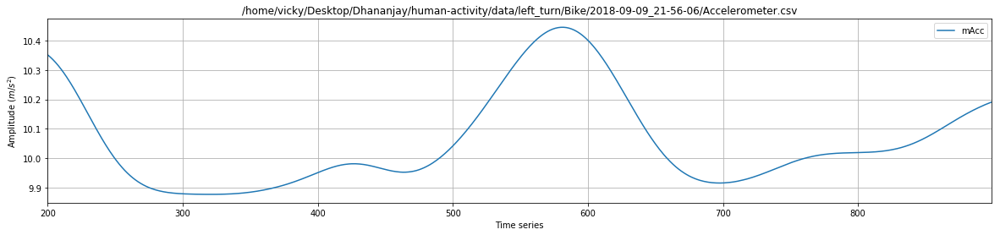

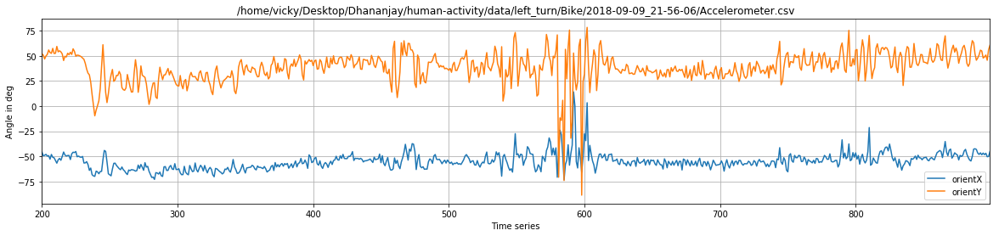

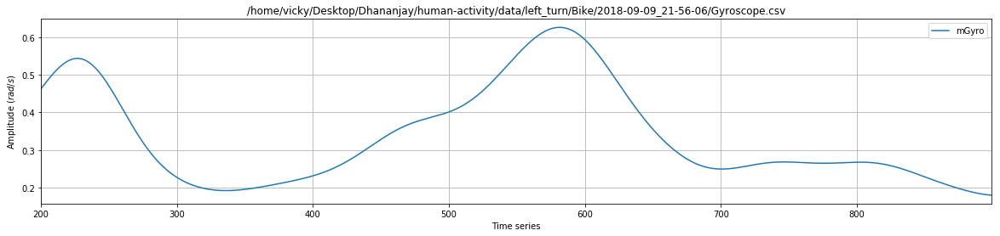

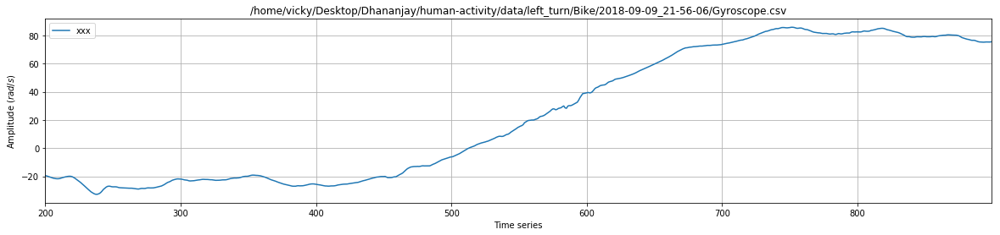

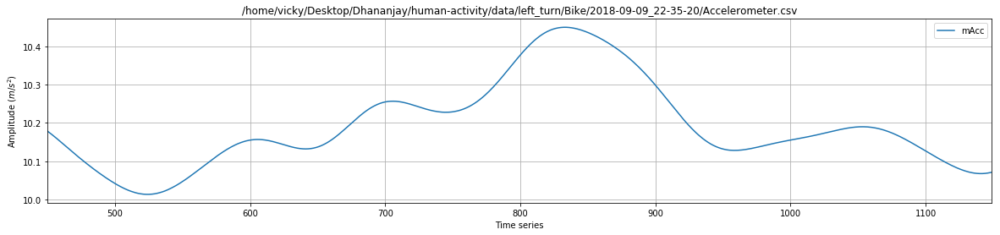

...

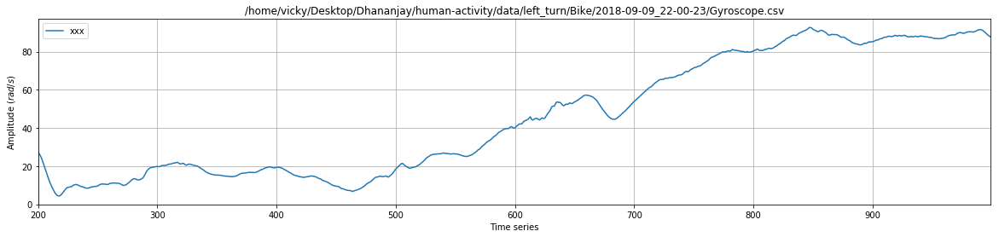

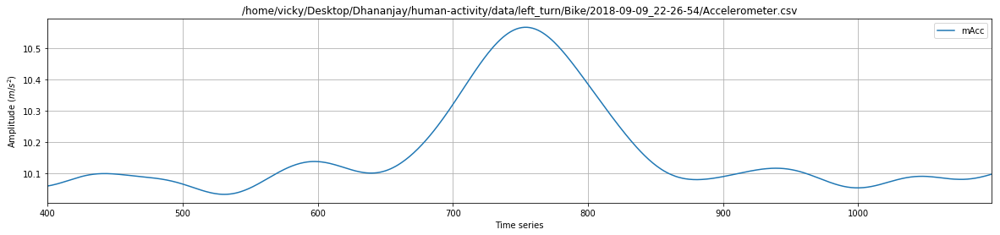

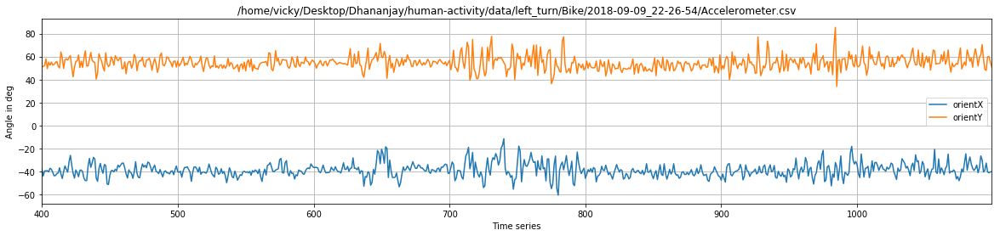

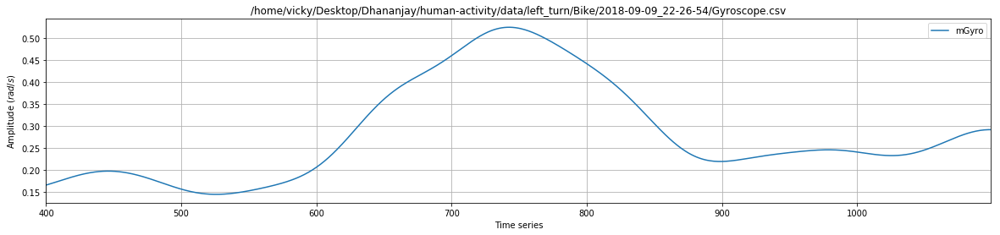

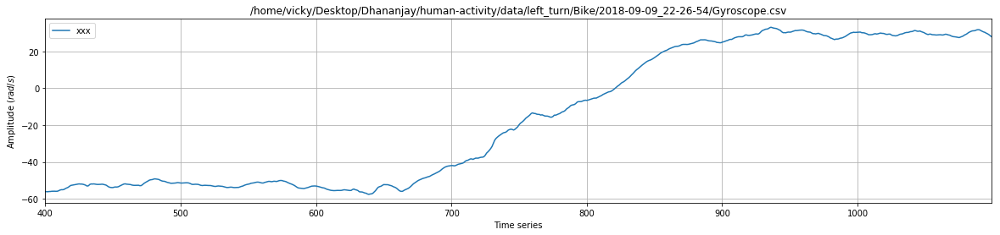

In [24]:
import time
path_acc  = os.getcwd() + '/data/left_turn/Bike/*/*Accelerometer.csv'  
path_gyro = os.getcwd() + '/data/left_turn/Bike/*/*Gyroscope.csv'
path_rot = os.getcwd() + '/data/left_turn/Bike/*/*Compass.csv' 
acc_files = glob.glob(path_acc)
gyro_files= glob.glob(path_gyro)
rot_files= glob.glob(path_rot)
bike_df= read_files(acc_files[0], gyro_files[0], 'bike')
n = len(bike_df)
bike_df = bike_df[200:n-300]
for acc_file, gyro_file, rot_file in zip(acc_files, gyro_files, rot_files) :
   
    
    path1 = acc_file.split('/')
    date_time = path1[9].split('_')
    key = date_time[1]
    value = fileVsIntervalLT[key]
    value_split = value.split('-')

    l = int(value_split[0])
    r = int(value_split[1])
    
    df_this = read_files(acc_file, gyro_file, 'bike')
    
    df_this = df_this[l-100:r+100]

    
    fig, ax = plt.subplots()
    df_this[['mAcc']].plot(figsize = (20,4),ax=ax, title = acc_file)
    plt.xlabel('Time series')
    plt.ylabel('Amplitude ($m/s^2$)')
    plt.grid('True')
    plt.savefig(acc_file +'.png')
    
    fig, ax = plt.subplots()
    df_this[['orientX','orientY']].plot(figsize = (20,4),ax=ax, title = acc_file)
    plt.xlabel('Time series')
    plt.ylabel('Angle in deg')
    plt.grid('True')
    plt.savefig(acc_file +'.png')
    
    fig, ax = plt.subplots()
    df_this[['mGyro']].plot(figsize = (20,4),ax=ax, title = gyro_file)
    plt.xlabel('Time series')
    plt.ylabel('Amplitude ($rad/s$)')
    plt.grid('True')
    plt.savefig(gyro_file +'.png')
    
    fig, ax = plt.subplots()
    df_this[['xxx']].plot(figsize = (20,4),ax=ax, title = gyro_file)
    plt.xlabel('Time series')
    plt.ylabel('Amplitude ($rad/s$)')
    plt.grid('True')
    plt.savefig(gyro_file +'.png')
    
    this_df_segments, this_labels = segmentation(df_this, 400)
    print(np.array(this_df_segments).shape)
    this_bike_dtw_data = DTWdistance(this_df_segments, ref)
    print(acc_file)
    print(gyro_file)
    for k in range(len(this_bike_dtw_data[0])):
        print(this_bike_dtw_data[6][k]," ", this_bike_dtw_data[7][k])
        
    print("-------------------------")
    
    bike_df = pd.concat([bike_df, df_this])
    
   

bike_df.reset_index(drop = True, inplace = True)
bike_df.head()


In [ ]:
import time
path_acc  = os.getcwd() + '/data/Bike2308/2018-08-23_16-18-07/Accelerometer.csv'
path_gyro = os.getcwd() + '/data/Bike2308/2018-08-23_16-18-07/Gyroscope.csv'
# path_rot = os.getcwd() + '/data/Bike2308/2018-08-23_16-18-07/Gyroscope.csv'

acc_files = glob.glob(path_acc)
gyro_files= glob.glob(path_gyro)
# rot_files= glob.glob(path_rot)
bike_df= read_files(acc_files[0], gyro_files[0], 'bike')
n = len(bike_df)
bike_df = bike_df[200:n-300]
for acc_file, gyro_file in zip(acc_files, gyro_files) :

    
#     path1 = acc_file.split('/')
#     date_time = path1[9].split('_')
#     key = date_time[1]
#     value = fileVsIntervalRT[key]
#     value_split = value.split('-')

#     l = int(value_split[0])
#     r = int(value_split[1])
    n = len(bike_df)
    df_this = read_files(acc_file, gyro_file, 'bike')
    
    n = len(df_this)
    df_this = df_this[100:n-100]
    
    fig, ax = plt.subplots()
    df_this[['mAcc']].plot(figsize = (20,4),ax=ax, title = acc_file)
    plt.xlabel('Time series')
    plt.ylabel('Amplitude ($m/s^2$)')
    plt.grid('True')
    plt.savefig(acc_file +'.png')
    
    fig, ax = plt.subplots()
    df_this[['mGyro']].plot(figsize = (20,4),ax=ax, title = gyro_file)
    plt.xlabel('Time series')
    plt.ylabel('Amplitude ($rad/s$)')
    plt.grid('True')
    plt.savefig(gyro_file +'.png')
    plt.close()
    
#     fig, ax = plt.subplots()
#     df_this[['xxx']].plot(figsize = (20,4),ax=ax, title = gyro_file)
#     plt.xlabel('Time series')
#     plt.ylabel('Amplitude ($rad/s$)')
#     plt.grid('True')
#     plt.savefig(gyro_file +'.png')
    
    this_df_segments, this_labels = segmentation(df_this, 400)
    print(np.array(this_df_segments).shape)
    this_bike_dtw_data = DTWdistance(this_df_segments, ref)
    
    print(acc_file)
    print(gyro_file)
    
    for k in range(len(this_bike_dtw_data[0])):
        print(this_bike_dtw_data[6][k]," ", this_bike_dtw_data[7][k])
        
    print("-------------------------")
    
    bike_df = pd.concat([bike_df, df_this])
    
   

bike_df.reset_index(drop = True, inplace = True)
bike_df.head()


(276, 11, 400)


(4, 11, 400)
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Car/2018-09-11_17-22-09/Accelerometer.csv
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Car/2018-09-11_17-22-09/Gyroscope.csv
195.869672035   8.59733273398
196.01629108   8.82834016013
196.102663823   8.96903271007
195.826028494   9.03490217678
-------------------------
(21, 11, 400)
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Car/2018-09-11_16-47-56/Accelerometer.csv
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Car/2018-09-11_16-47-56/Gyroscope.csv
195.810709543   2.10313171874
195.817927997   2.38105758027
195.868878037   2.92495183772
195.825142422   3.01740715042
195.621266666   2.95471202526
195.56628908   2.97852759651
195.694554022   3.04893206229
195.753537612   2.98152388988
195.784299782   2.9098915946
195.865156938   2.75805342538
195.701458314   2.61617000181
195.694983474   3.15926687183
196.064715031   4.25679289833
196.485482639   5.24912667614
196.622453

/home/vicky/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


(13, 11, 400)
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Car/2018-09-11_17-20-22/Accelerometer.csv
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Car/2018-09-11_17-20-22/Gyroscope.csv
192.665082648   4.9508039365
192.74832264   4.8340678224
193.333751475   4.72781846748
193.67710452   4.87359999775
194.033354024   5.49882744676
194.909744474   6.33000118754
195.552788665   7.01952885584
195.835131277   7.46662222096
195.827561048   7.67646800926
195.746282934   8.01482980351
195.284396619   8.4968211136
195.211660312   8.8757909906
195.021990635   8.69754838321
-------------------------
(19, 11, 400)
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Car/2018-09-11_16-52-45/Accelerometer.csv
/home/vicky/Desktop/Dhananjay/human-activity/data/left_turn/Car/2018-09-11_16-52-45/Gyroscope.csv
194.934938834   2.56722241015
194.977714956   2.77501682184
194.988338541   3.07513297181
195.006879057   3.11194789642
194.982823643   3.07489758447
195.07283794

,AX,AY,AZ,GX,GY,GZ,RX,RY,RZ,activity,...,AZ1,GX1,GY1,GZ1,fAX,fAY,fAZ,fGX,fGY,fGZ
0,9.364105,0.845442,-2.335916,-0.011794,-0.006739,0.003280,-4.988098,-3.054810,-57.630920,car,...,1.888759,-0.011515,0.004451,0.001802,0.149435,-4.111049,4.474458,0.149435,-4.111049,4.474458
1,9.363433,0.838371,-2.337865,-0.011906,-0.006908,0.003628,-5.908203,-3.332520,-60.743713,car,...,1.866369,-0.011539,0.004767,0.002061,-0.089226,2.460757,-2.678162,-0.089226,2.460757,-2.678162
2,9.362733,0.831009,-2.339818,-0.012020,-0.007075,0.003977,-4.119873,-3.100586,-60.398865,car,...,1.843197,-0.011563,0.005084,0.002320,0.148445,-4.086492,4.447234,0.148445,-4.086492,4.447234
3,9.362003,0.823360,-2.341769,-0.012135,-0.007240,0.004326,-4.705811,-3.161621,-59.172060,car,...,1.819253,-0.011586,0.005402,0.002580,-0.089348,2.461320,-2.678399,-0.089348,2.461320,-2.678399
4,9.361251,0.815432,-2.343724,-0.012252,-0.007404,0.004673,-4.101562,-2.600098,-60.092163,car,...,1.794563,-0.011609,0.005719,0.002840,0.147885,-4.061831,4.420735,0.147885,-4.061831,4.420735


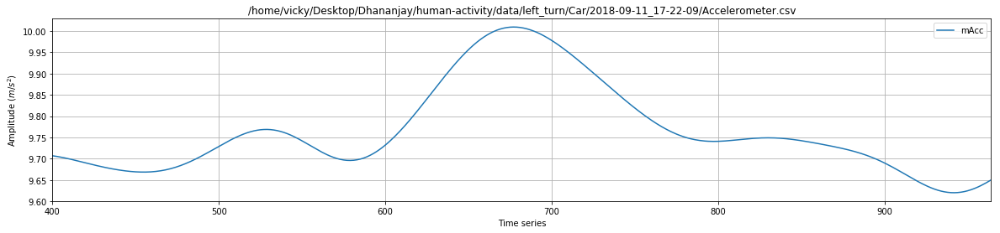

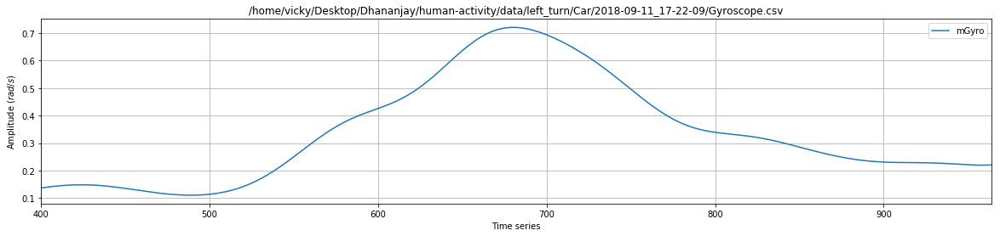

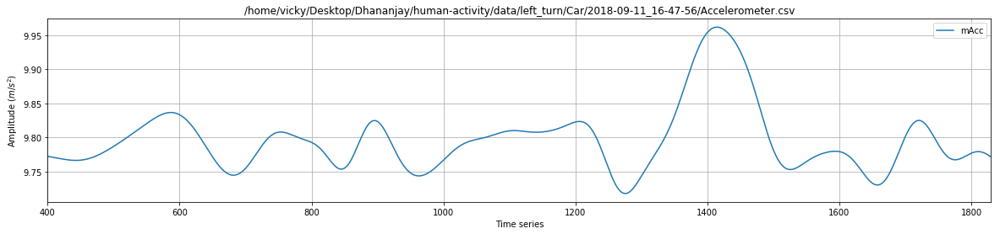

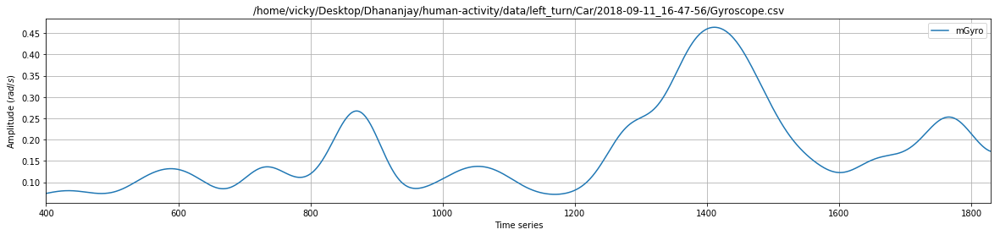

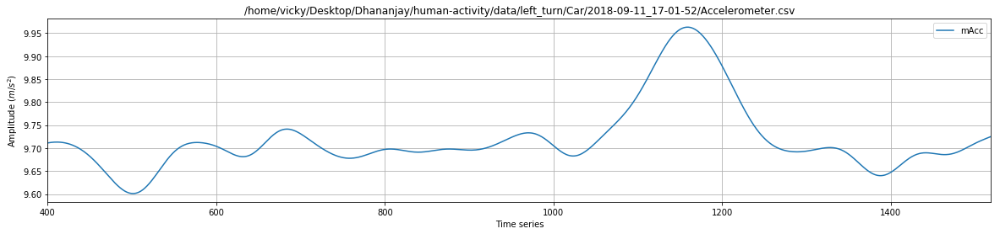

...

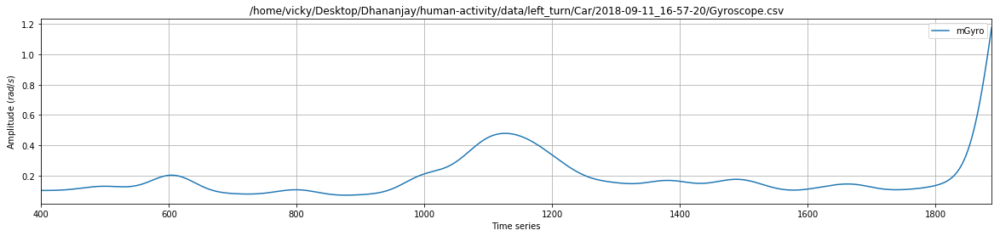

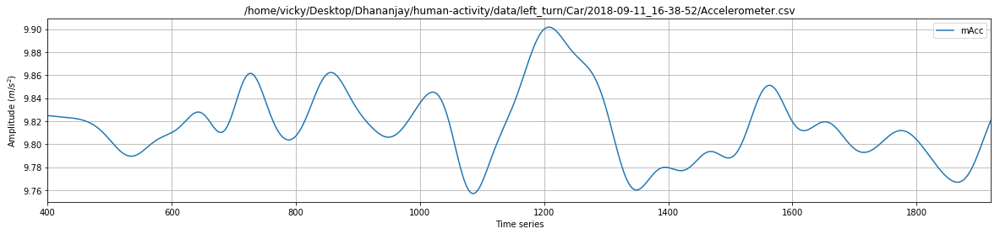

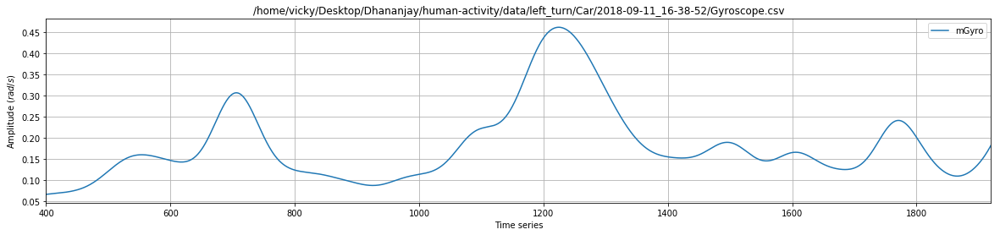

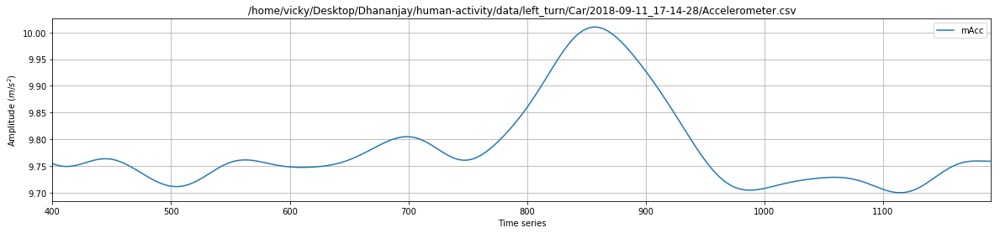

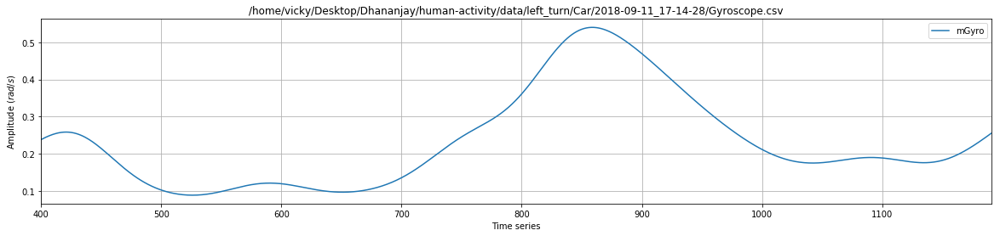

In [50]:
import time
path_acc  = os.getcwd() + '/data/left_turn/Car/*/*Accelerometer.csv'  
path_gyro = os.getcwd() + '/data/left_turn/Car/*/*Gyroscope.csv'
path_rot = os.getcwd() + '/data/left_turn/Car/*/*Compass.csv' 

acc_files = glob.glob(path_acc)
gyro_files= glob.glob(path_gyro)
rot_files= glob.glob(path_rot)

car_df= read_files(acc_files[0], gyro_files[0],rot_files[0], 'car')
n = len(car_df)
car_df = car_df[400:n-300]
for acc_file, gyro_file, rot_file in zip(acc_files, gyro_files, rot_files) :

    
#     path1 = acc_file.split('/')
#     date_time = path1[9].split('_')
#     key = date_time[1]
#     value = fileVsIntervalRT[key]
#     value_split = value.split('-')

#     l = int(value_split[0])
#     r = int(value_split[1])
    
    
    df_this = read_files(acc_file, gyro_file,rot_file, 'bike')
    n = len(df_this)
    df_this = df_this[400:n-200]
    
    fig, ax = plt.subplots()
    df_this[['mAcc']].plot(figsize = (20,4),ax=ax, title = acc_file)
    plt.xlabel('Time series')
    plt.ylabel('Amplitude ($m/s^2$)')
    plt.grid('True')
    plt.savefig(acc_file +'.png')
    
    fig, ax = plt.subplots()
    df_this[['mGyro']].plot(figsize = (20,4),ax=ax, title = gyro_file)
    plt.xlabel('Time series')
    plt.ylabel('Amplitude ($rad/s$)')
    plt.grid('True')
    plt.savefig(gyro_file +'.png')
    
    fig, ax = plt.subplots()
    df_this[['fAX', 'fAY', 'fAZ']].plot(figsize = (20,4),ax=ax, title = gyro_file)
    plt.xlabel('Time series')
    plt.ylabel('Amplitude ($rad/s$)')
    plt.grid('True')
    plt.savefig(gyro_file +'.png')
    
    
    fig, ax = plt.subplots()
    df_this[['xxx']].plot(figsize = (20,4),ax=ax, title = gyro_file)
    plt.xlabel('Time series')
    plt.ylabel('Amplitude ($rad/s$)')
    plt.grid('True')
    plt.savefig(gyro_file +'.png')
    
    this_df_segments, this_labels = segmentation(df_this, 400)
    print(np.array(this_df_segments).shape)
    this_car_dtw_data = DTWdistance(this_df_segments, ref)
    
    
    print(acc_file)
    print(gyro_file)
    
    for k in range(len(this_car_dtw_data[0])):
        print(this_car_dtw_data[6][k]," ", this_car_dtw_data[7][k])
        
    print("-------------------------")
    
    car_df = pd.concat([car_df, df_this])
    
   

car_df.reset_index(drop = True, inplace = True)
car_df.head()


(16, 11, 400)
/home/vicky/Desktop/Dhananjay/human-activity/data/right_turn/Car/2018-09-11_16-49-13/Accelerometer.csv
/home/vicky/Desktop/Dhananjay/human-activity/data/right_turn/Car/2018-09-11_16-49-13/Gyroscope.csv
195.843070891   2.95431912611
196.137888198   3.21723619647
196.642577365   3.8007068362
197.402558707   4.52768308958
198.046830458   5.21660344965
198.199693618   5.57447516571
198.209066414   5.66897428277
198.264716924   5.60154304517
198.068217687   5.54440382929
197.641503198   5.38799268967
197.011930745   4.9795755481
196.190112007   4.27385607386
195.641259576   3.23632257435
195.573259252   2.51726695978
195.565715563   2.50944364512
195.632284319   2.74602361857
-------------------------
(8, 11, 400)
/home/vicky/Desktop/Dhananjay/human-activity/data/right_turn/Car/2018-09-11_17-13-25/Accelerometer.csv
/home/vicky/Desktop/Dhananjay/human-activity/data/right_turn/Car/2018-09-11_17-13-25/Gyroscope.csv
195.35326687   4.46821838263
195.81296096   5.1194778219
196.2005

/home/vicky/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


(18, 11, 400)
/home/vicky/Desktop/Dhananjay/human-activity/data/right_turn/Car/2018-09-11_17-23-00/Accelerometer.csv
/home/vicky/Desktop/Dhananjay/human-activity/data/right_turn/Car/2018-09-11_17-23-00/Gyroscope.csv
193.924457366   5.73545170171
194.390067172   5.96911000861
195.119013944   6.53420939388
195.860802359   7.60034820566
196.280280354   8.91336855311
196.19352731   9.43450538261
196.006832919   9.56881627099
195.972575643   9.23363551229
195.596246981   8.93097285998
194.921495999   8.73994741536
194.096907365   8.32419380198
193.358352953   7.36462649692
192.999840166   5.81414781128
192.988886523   5.38956315106
193.186809075   5.02897673457
193.179101658   5.09040126334
193.330684577   5.39436231794
193.472098685   5.54544089452
-------------------------
(13, 11, 400)
/home/vicky/Desktop/Dhananjay/human-activity/data/right_turn/Car/2018-09-11_17-09-18/Accelerometer.csv
/home/vicky/Desktop/Dhananjay/human-activity/data/right_turn/Car/2018-09-11_17-09-18/Gyroscope.csv
194

(7, 11, 400)
/home/vicky/Desktop/Dhananjay/human-activity/data/right_turn/Car/2018-09-11_17-00-44/Accelerometer.csv
/home/vicky/Desktop/Dhananjay/human-activity/data/right_turn/Car/2018-09-11_17-00-44/Gyroscope.csv
195.22283001   5.217676956
195.734303069   5.75587416417
195.943554417   6.11634214785
195.860058355   6.09675937874
195.9445079   5.92434982762
195.856557405   5.78627725874
195.530328627   5.63182785371
-------------------------
(26, 11, 400)
/home/vicky/Desktop/Dhananjay/human-activity/data/right_turn/Car/2018-09-11_16-37-24/Accelerometer.csv
/home/vicky/Desktop/Dhananjay/human-activity/data/right_turn/Car/2018-09-11_16-37-24/Gyroscope.csv
196.644841147   2.99730489083
196.663637397   3.12657868367
196.873263519   3.39631867534
197.298254694   3.95338936175
197.988885238   4.69124664453
198.626730741   5.277931705
198.678943413   5.47139991757
198.557488552   5.55804874986
198.566297522   5.54973643375
198.492374945   5.50586438611
198.261405829   5.3614111409
197.8031486

,AX,AY,AZ,GX,GY,GZ,RX,RY,RZ,activity,...,AZ1,GX1,GY1,GZ1,fAX,fAY,fAZ,fGX,fGY,fGZ
0,8.940631,-1.970239,-3.455646,-0.004709,0.006650,-0.004581,6.567383,27.967834,-27.644348,car,...,-4.106017,-0.008972,0.000144,-0.003424,-0.133251,0.621340,-0.663621,-0.133251,0.621340,-0.663621
1,8.942178,-1.962336,-3.455755,-0.004466,0.006455,-0.004302,7.809448,29.322815,-25.772095,car,...,-4.098745,-0.008588,0.000189,-0.003314,0.360754,-1.679716,1.795552,0.360754,-1.679716,1.795552
2,8.943680,-1.954771,-3.455826,-0.004226,0.006264,-0.004022,5.972290,28.135681,-28.585815,car,...,-4.091820,-0.008207,0.000237,-0.003206,-0.133281,0.621697,-0.664085,-0.133281,0.621697,-0.664085
3,8.945153,-1.947544,-3.455863,-0.003989,0.006076,-0.003744,6.567383,27.774048,-26.713562,car,...,-4.085246,-0.007831,0.000287,-0.003097,0.358851,-1.670380,1.786394,0.358851,-1.670380,1.786394
4,8.946598,-1.940663,-3.455858,-0.003753,0.005895,-0.003467,6.555176,27.236938,-25.782776,car,...,-4.079037,-0.007462,0.000339,-0.002992,-0.133236,0.621870,-0.664862,-0.133236,0.621870,-0.664862


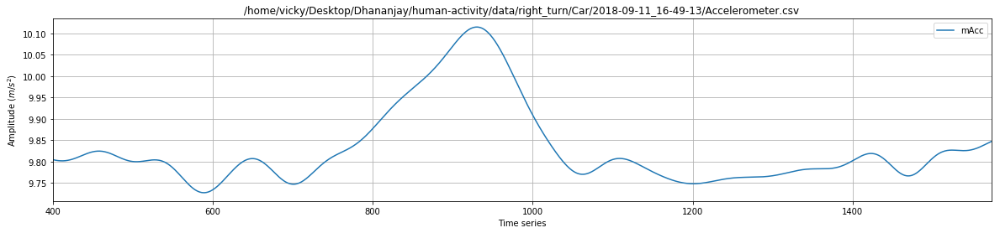

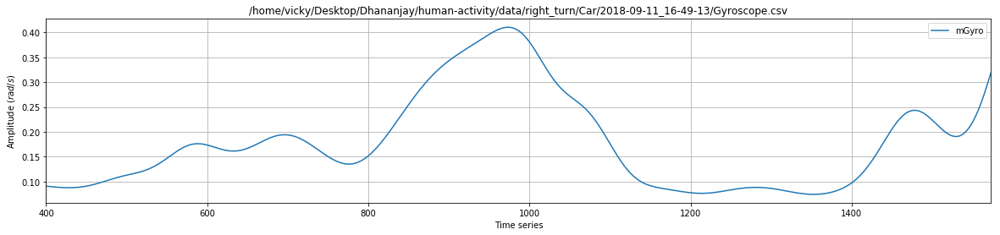

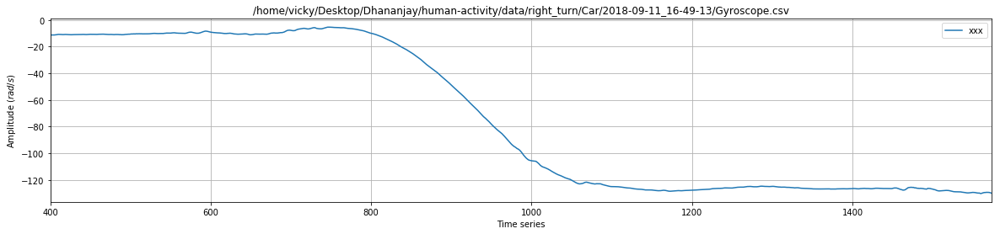

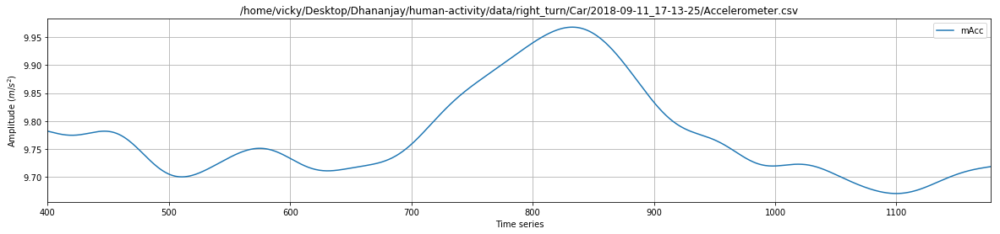

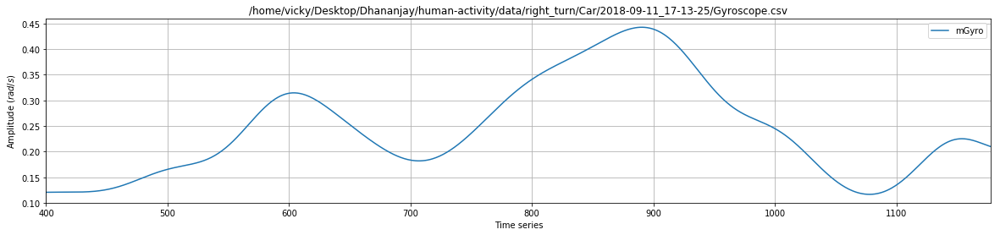

...

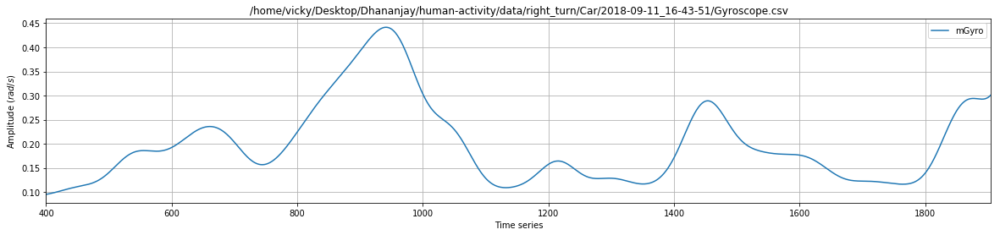

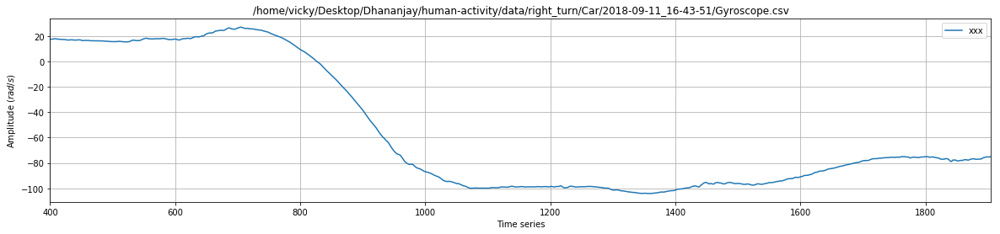

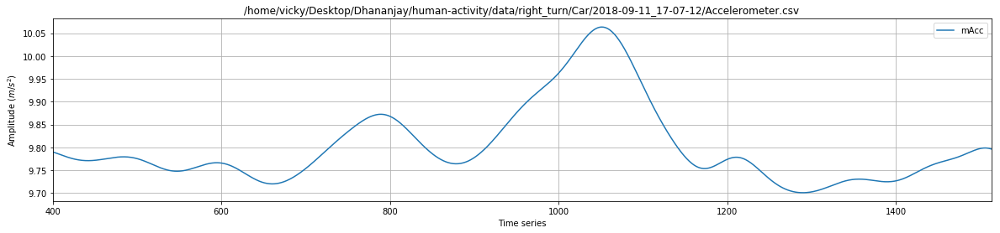

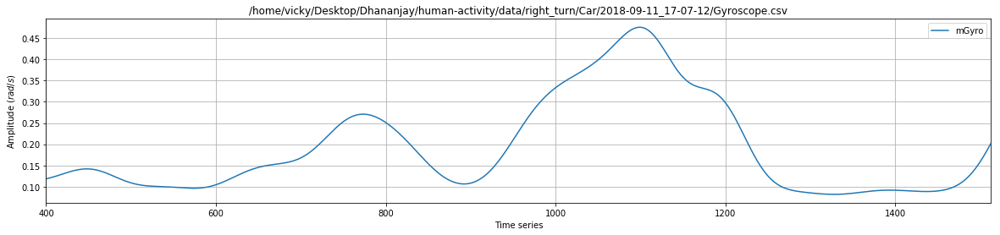

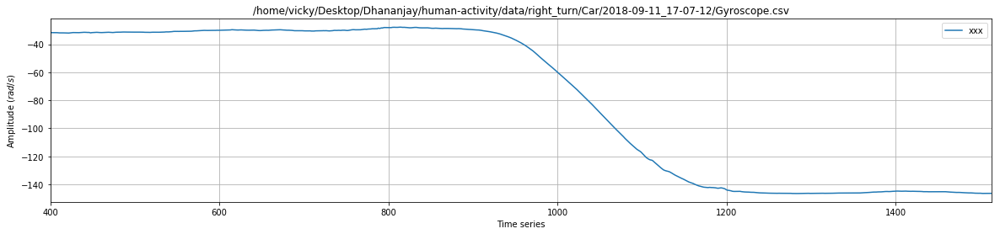

In [49]:
import time
path_acc  = os.getcwd() + '/data/right_turn/Car/*/*Accelerometer.csv'  
path_gyro = os.getcwd() + '/data/right_turn/Car/*/*Gyroscope.csv'
path_rot = os.getcwd() + '/data/right_turn/Car/*/*Compass.csv' 

acc_files = glob.glob(path_acc)
gyro_files= glob.glob(path_gyro)
rot_files= glob.glob(path_rot)

car_df= read_files(acc_files[0], gyro_files[0],rot_files[0], 'car')
n = len(car_df)
car_df = car_df[400:n-300]
for acc_file, gyro_file, rot_file in zip(acc_files, gyro_files, rot_files) :

    
#     path1 = acc_file.split('/')
#     date_time = path1[9].split('_')
#     key = date_time[1]
#     value = fileVsIntervalRT[key]
#     value_split = value.split('-')

#     l = int(value_split[0])
#     r = int(value_split[1])
    
    
    df_this = read_files(acc_file, gyro_file,rot_file, 'bike')
    n = len(df_this)
    if(n<800):
        continue
       
    df_this = df_this[400:n-200]
    
    fig, ax = plt.subplots()
    df_this[['mAcc']].plot(figsize = (20,4),ax=ax, title = acc_file)
    plt.xlabel('Time series')
    plt.ylabel('Amplitude ($m/s^2$)')
    plt.grid('True')
    plt.savefig(acc_file +'.png')
    
    fig, ax = plt.subplots()
    df_this[['mGyro']].plot(figsize = (20,4),ax=ax, title = gyro_file)
    plt.xlabel('Time series')
    plt.ylabel('Amplitude ($rad/s$)')
    plt.grid('True')
    plt.savefig(gyro_file +'.png')
    
    fig, ax = plt.subplots()
    df_this[['xxx']].plot(figsize = (20,4),ax=ax, title = gyro_file)
    plt.xlabel('Time series')
    plt.ylabel('Amplitude ($rad/s$)')
    plt.grid('True')
    plt.savefig(gyro_file +'.png')
    
    this_df_segments, this_labels = segmentation(df_this, 400)
    print(np.array(this_df_segments).shape)
    this_car_dtw_data = DTWdistance(this_df_segments, ref)
    
    print(acc_file)
    print(gyro_file)
    
    for k in range(len(this_car_dtw_data[0])):
        print(this_car_dtw_data[6][k]," ", this_car_dtw_data[7][k])
        
    print("-------------------------")
    
    car_df = pd.concat([car_df, df_this])


car_df.reset_index(drop = True, inplace = True)
car_df.head()


/home/vicky/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


,AX,AX1,AY,AY1,AZ,AZ1,GX,GX1,GY,GY1,...,mGyro,orientX,orientY,orientZ,quaternionW,quaternionX,quaternionY,quaternionZ,xxx,yyy
0,7.478536,1.837731,-5.381251,-8.442184,-4.284115,-5.071696,-0.095325,-0.274902,0.085605,-0.037671,...,0.462613,-45.678830,52.146007,-27.210548,0.844711,-0.243584,0.475704,-0.028916,-0.003400,0.019079
1,7.505609,1.902669,-5.336031,-8.425648,-4.277680,-5.064853,-0.096087,-0.279584,0.085199,-0.041199,...,0.467369,-49.437194,50.814050,-25.446893,0.839883,-0.282606,0.463354,-0.005710,-0.003438,0.019013
2,7.532405,1.967580,-5.290179,-8.408683,-4.271220,-5.057378,-0.096771,-0.284121,0.084742,-0.044763,...,0.472091,-48.970570,46.948293,-27.059776,0.850209,-0.284798,0.441391,-0.034780,-0.003497,0.018964
3,7.558917,2.032411,-5.243700,-8.391317,-4.264765,-5.049261,-0.097374,-0.288507,0.084241,-0.048353,...,0.476762,-48.068237,49.996113,-26.572851,0.845145,-0.270548,0.460452,-0.022727,-0.003562,0.018856
4,7.585149,2.097203,-5.196608,-8.373550,-4.258299,-5.040520,-0.097896,-0.292729,0.083688,-0.051971,...,0.481376,-49.765622,51.520650,-24.984031,0.837229,-0.284696,0.466897,0.001815,-0.003625,0.018784


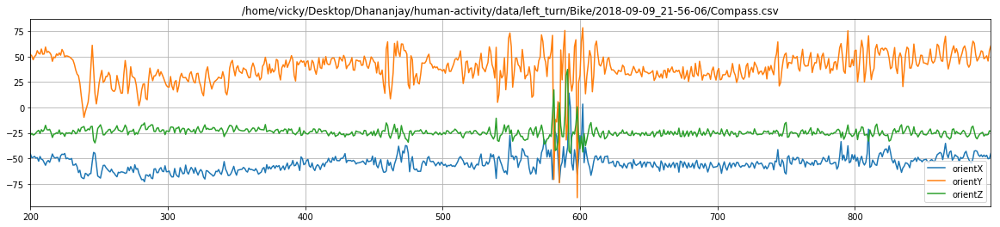

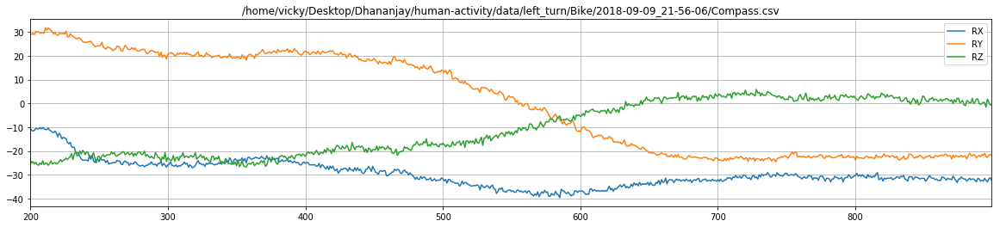

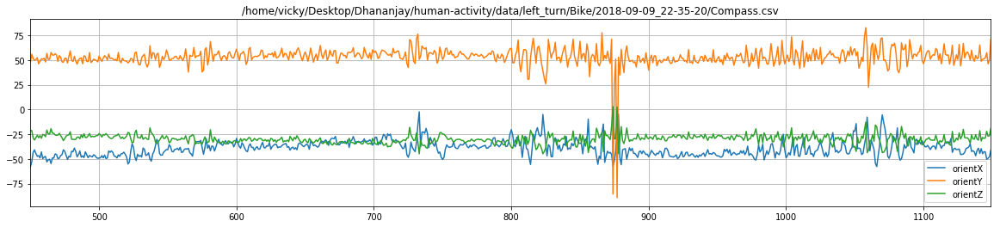

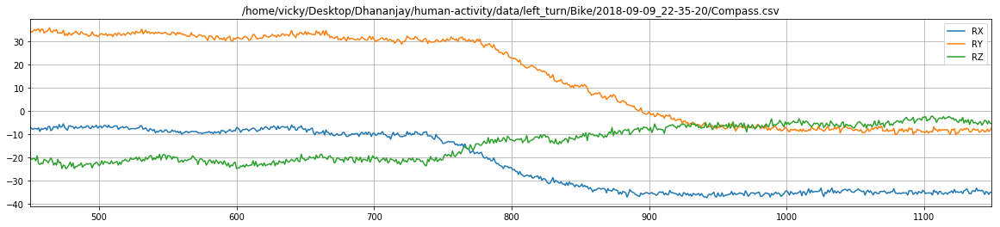

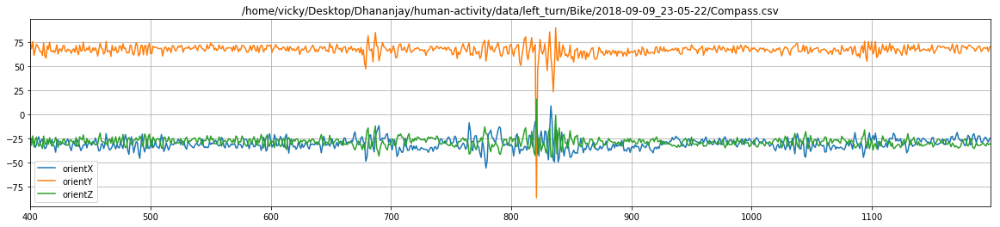

...

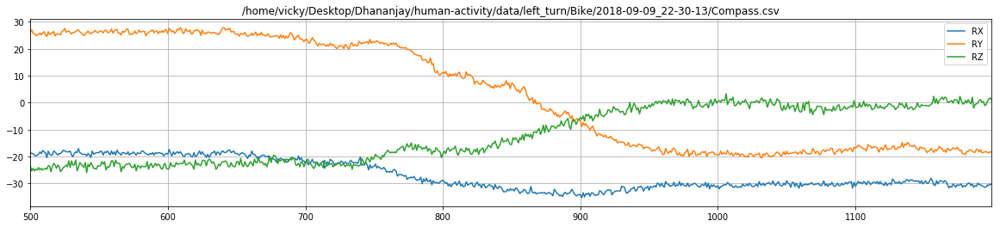

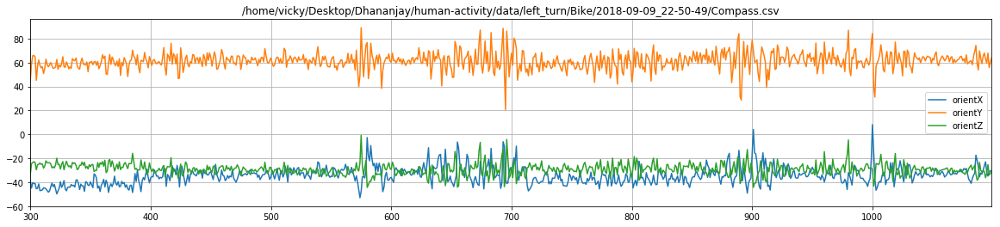

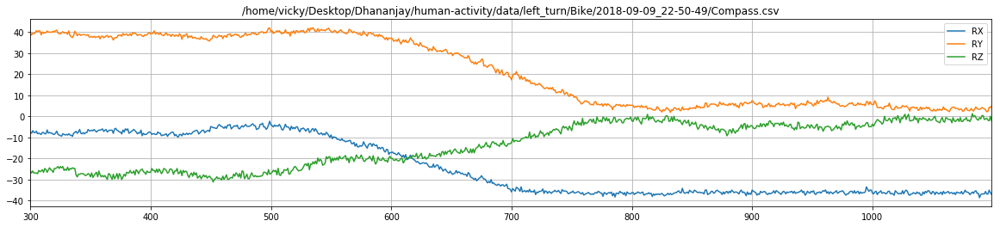

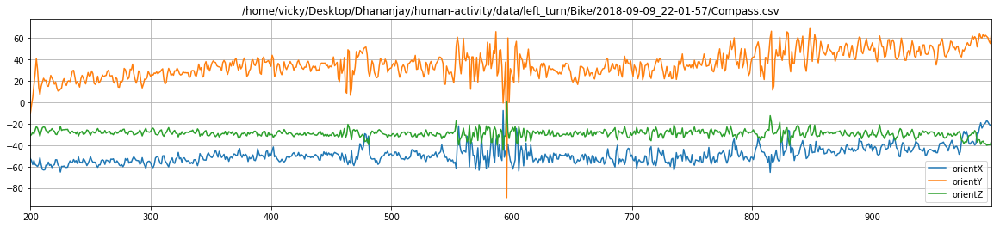

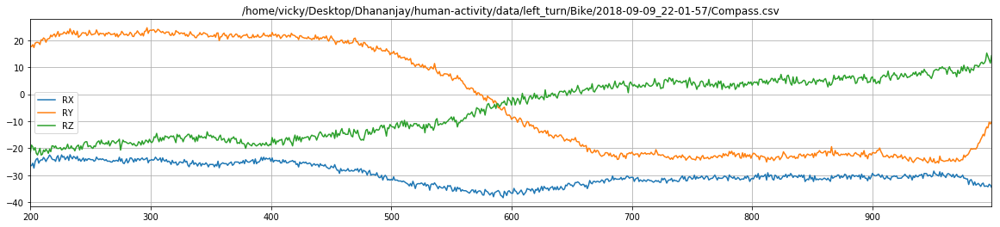

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


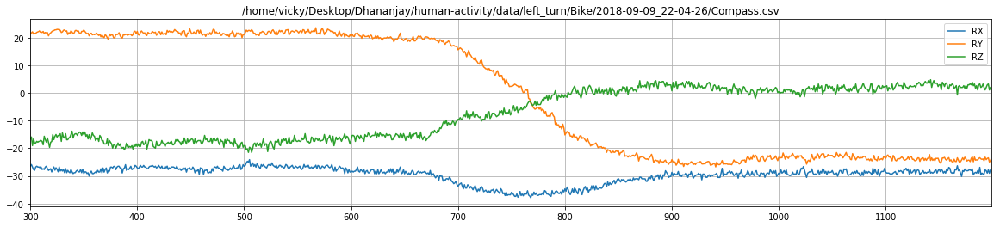

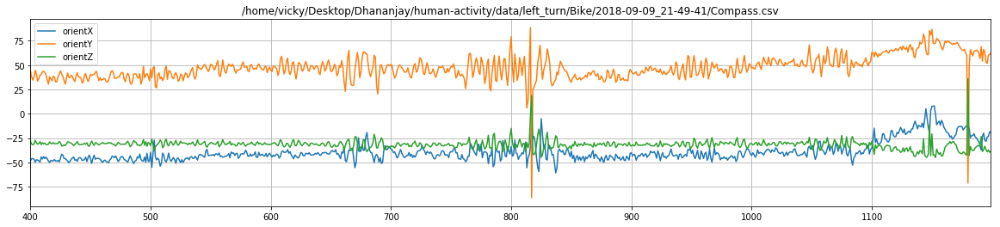

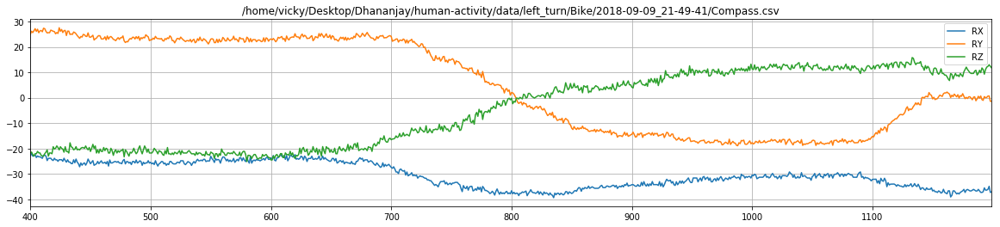

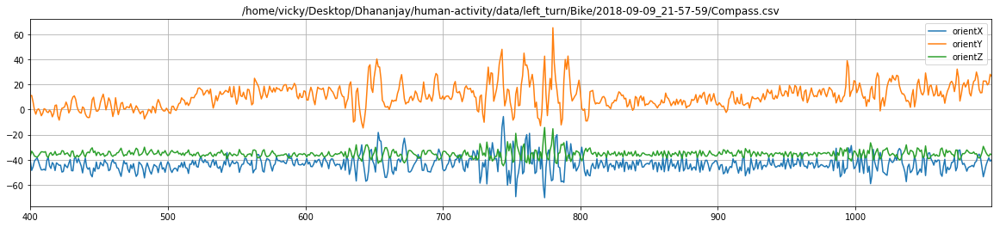

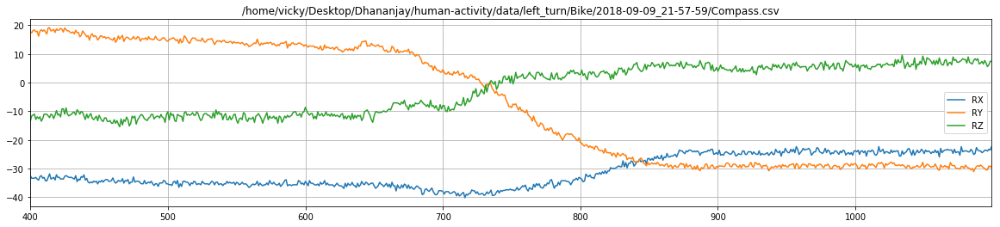

...

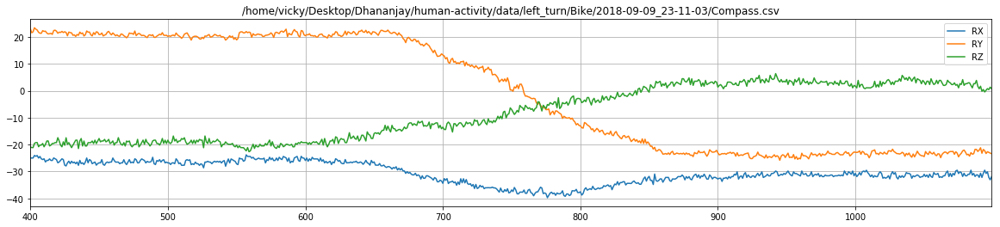

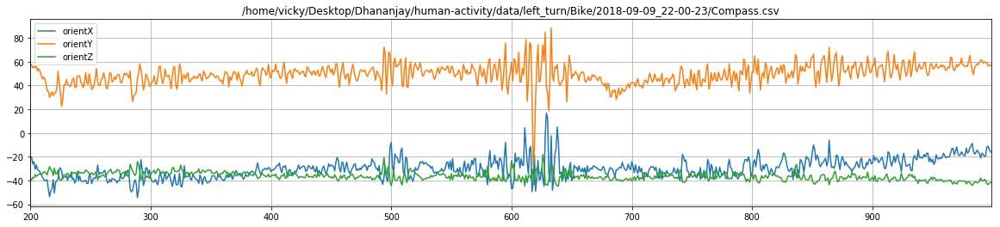

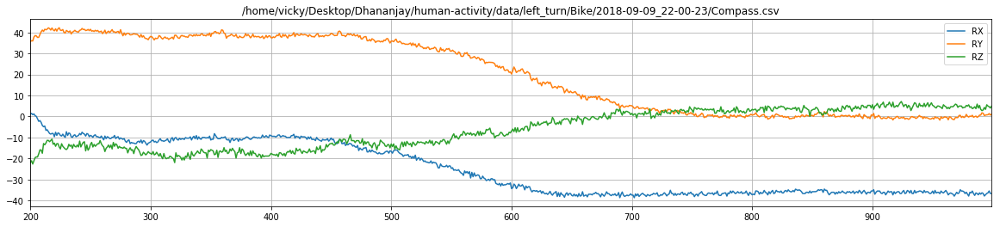

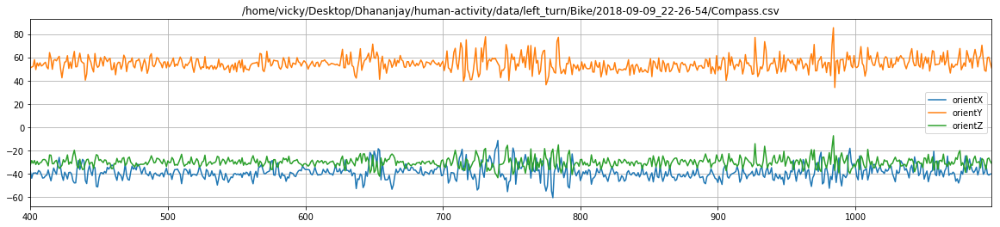

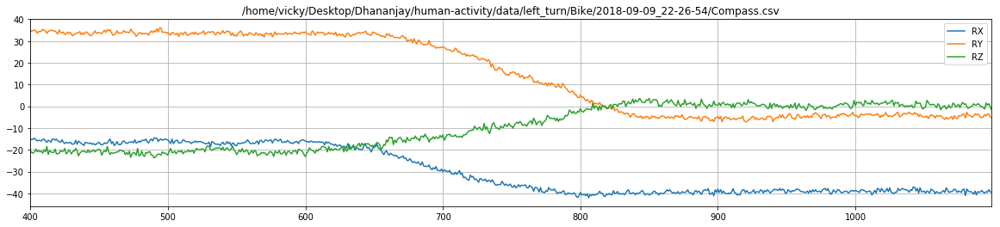

In [28]:
import time
path_acc  = os.getcwd() + '/data/left_turn/Bike/*/*Accelerometer.csv'  
path_gyro = os.getcwd() + '/data/left_turn/Bike/*/*Gyroscope.csv'
path_rot = os.getcwd() + '/data/left_turn/Bike/*/*Compass.csv' 
acc_files = glob.glob(path_acc)
gyro_files= glob.glob(path_gyro)
rot_files= glob.glob(path_rot)
bike_df= read_files(acc_files[0], gyro_files[0],rot_files[0], 'bike')
n = len(bike_df)
bike_df = bike_df[200:n-300]
for acc_file, gyro_file, rot_file in zip(acc_files, gyro_files, rot_files) :
#     print(acc_file)
#     print(gyro_file)

    path1 = acc_file.split('/')
    date_time = path1[9].split('_')
    key = date_time[1]
    value = fileVsIntervalLT[key]
    value_split = value.split('-')

    l = int(value_split[0])
    r = int(value_split[1])
    
    df_this = read_files(acc_file, gyro_file,rot_file, 'bike')

    
    df_this = df_this[l-100:r + 100]
    
        
    fig, ax = plt.subplots()
    df_this[['orientX','orientY','orientZ']].plot(figsize = (20,4),ax=ax, title = rot_file)
    plt.grid('True')
    n = len(df_this)
    
    fig, ax = plt.subplots()
    df_this[['RX','RY','RZ']].plot(figsize = (20,4),ax=ax, title = rot_file)
    plt.grid('True')
    
    bike_df = pd.concat([bike_df, df_this])
   

bike_df.reset_index(drop = True, inplace = True)
bike_df.head()


/home/vicky/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


,AX,AY,AZ,GX,GY,GZ,RX,RY,RZ,activity,...,AZ1,GX1,GY1,GZ1,fAX,fAY,fAZ,fGX,fGY,fGZ
0,9.364105,0.845442,-2.335916,-0.011794,-0.006739,0.003280,-4.988098,-3.054810,-57.630920,car,...,1.888759,-0.011515,0.004451,0.001802,0.149435,-4.111049,4.474458,0.149435,-4.111049,4.474458
1,9.363433,0.838371,-2.337865,-0.011906,-0.006908,0.003628,-5.908203,-3.332520,-60.743713,car,...,1.866369,-0.011539,0.004767,0.002061,-0.089226,2.460757,-2.678162,-0.089226,2.460757,-2.678162
2,9.362733,0.831009,-2.339818,-0.012020,-0.007075,0.003977,-4.119873,-3.100586,-60.398865,car,...,1.843197,-0.011563,0.005084,0.002320,0.148445,-4.086492,4.447234,0.148445,-4.086492,4.447234
3,9.362003,0.823360,-2.341769,-0.012135,-0.007240,0.004326,-4.705811,-3.161621,-59.172060,car,...,1.819253,-0.011586,0.005402,0.002580,-0.089348,2.461320,-2.678399,-0.089348,2.461320,-2.678399
4,9.361251,0.815432,-2.343724,-0.012252,-0.007404,0.004673,-4.101562,-2.600098,-60.092163,car,...,1.794563,-0.011609,0.005719,0.002840,0.147885,-4.061831,4.420735,0.147885,-4.061831,4.420735


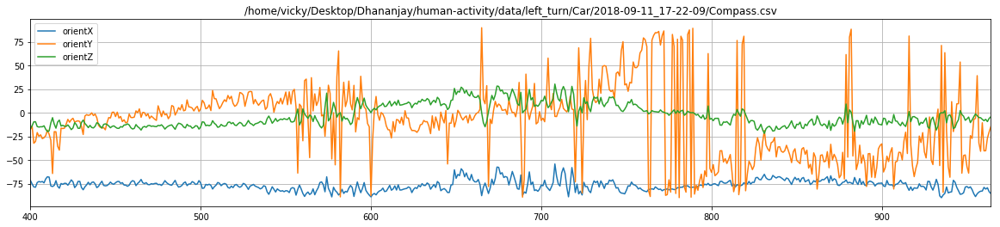

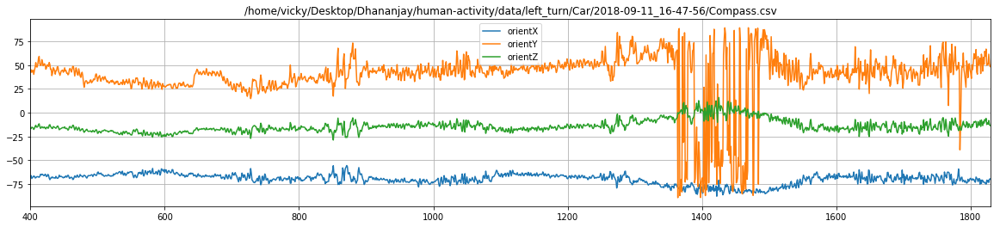

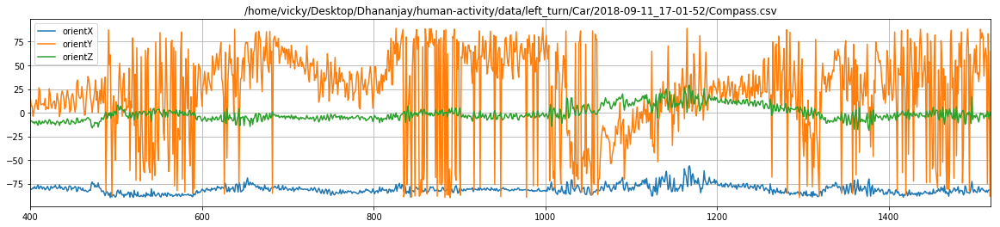

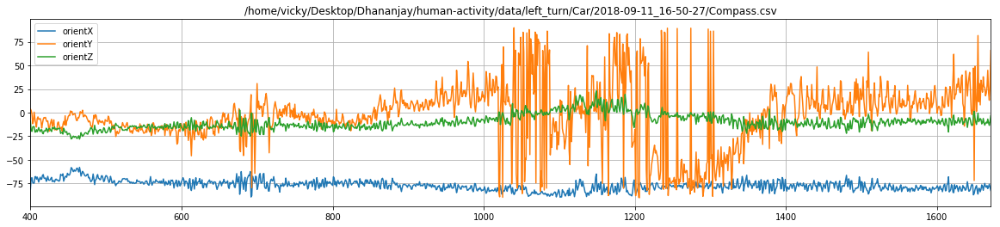

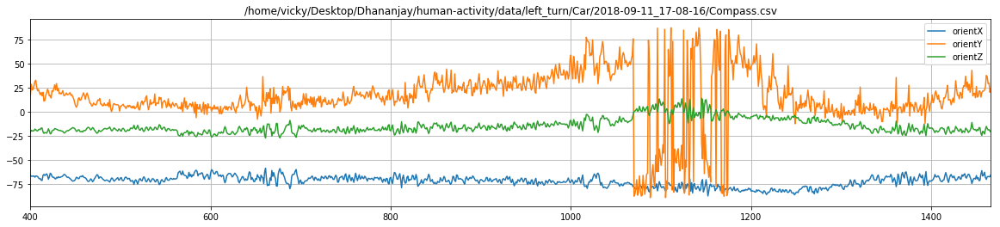

...

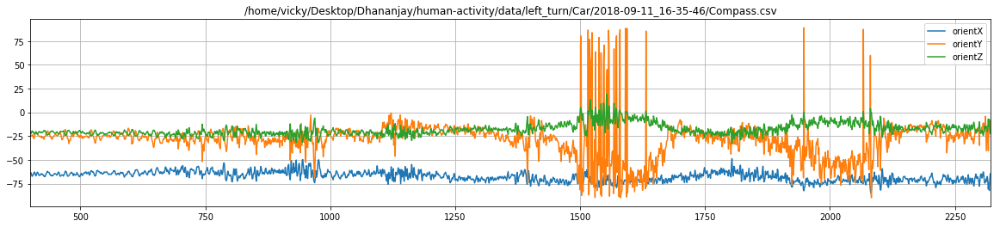

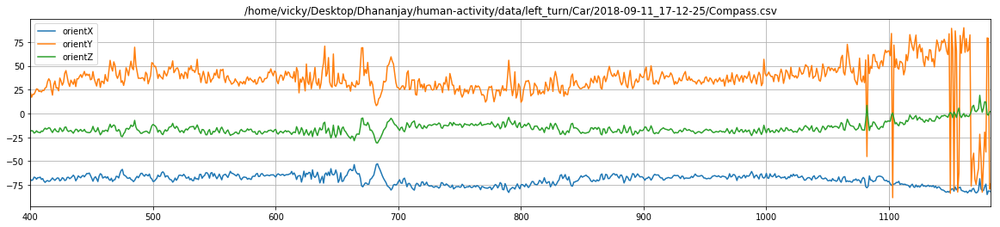

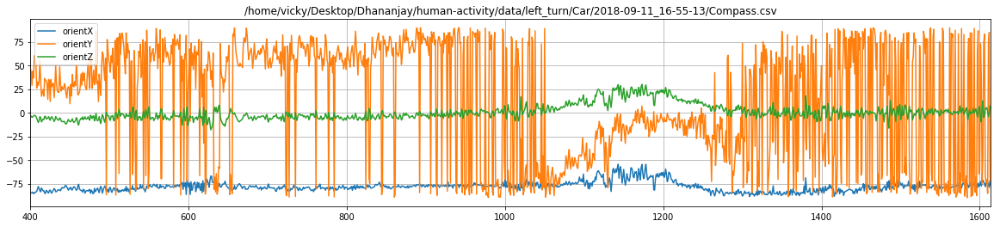

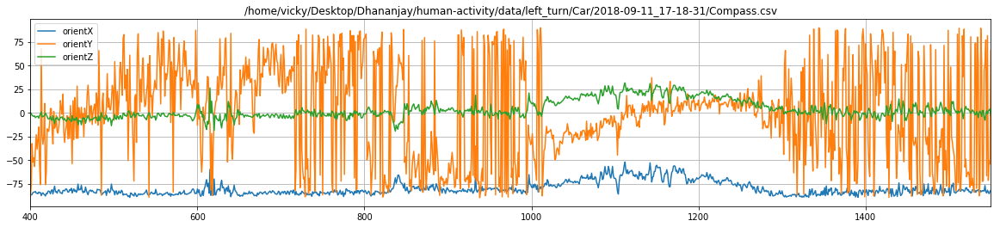

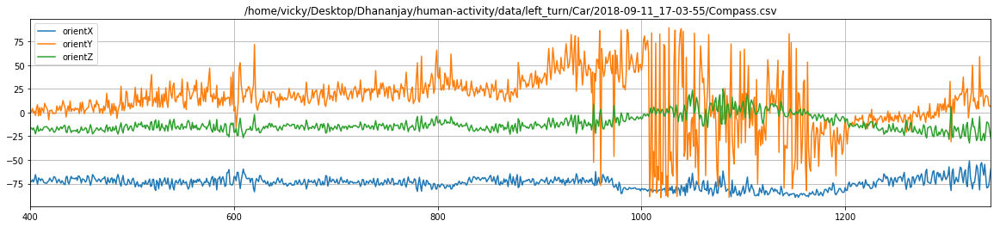

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


In [52]:
import time
path_acc  = os.getcwd() + '/data/left_turn/Car/*/*Accelerometer.csv'  
path_gyro = os.getcwd() + '/data/left_turn/Car/*/*Gyroscope.csv'
path_rot = os.getcwd() + '/data/left_turn/Car/*/*Compass.csv' 

acc_files = glob.glob(path_acc)
gyro_files= glob.glob(path_gyro)
rot_files= glob.glob(path_rot)

car_df= read_files(acc_files[0], gyro_files[0],rot_files[0], 'car')
n = len(car_df)
car_df = car_df[400:n-300]
for acc_file, gyro_file, rot_file in zip(acc_files, gyro_files, rot_files) :

    
#     path1 = acc_file.split('/')
#     date_time = path1[9].split('_')
#     key = date_time[1]
#     value = fileVsIntervalRT[key]
#     value_split = value.split('-')

#     l = int(value_split[0])
#     r = int(value_split[1])
    
    
    df_this = read_files(acc_file, gyro_file,rot_file, 'bike')
    n = len(df_this)
    df_this = df_this[400:n-200]
    
    fig, ax = plt.subplots()
    df_this[['orientX','orientY','orientZ']].plot(figsize = (20,4),ax=ax, title = rot_file)
    plt.grid('True')
    n = len(df_this)
    
    
    
    car_df = pd.concat([car_df, df_this])
    
   

car_df.reset_index(drop = True, inplace = True)
car_df.head()


In [191]:
ref  = [0.0]*400
len(ref)


400

In [192]:
bike_dtw_data = DTWdistance(bike_segments, ref)

calculating loss for feature  0 ....
Done
calculating loss for feature  1 ....
Done
calculating loss for feature  2 ....
Done
calculating loss for feature  3 ....
Done
calculating loss for feature  4 ....
Done
calculating loss for feature  5 ....
Done
calculating loss for feature  6 ....
Done
calculating loss for feature  7 ....
Done
calculating loss for feature  8 ....
Done
calculating loss for feature  9 ....
Done
calculating loss for feature  10 ....
Done


In [193]:
print(np.array(bike_dtw_data).shape)
bike_dtw_data = [*zip(*bike_dtw_data)]
print(np.array(bike_dtw_data).shape)

(11, 1104)
(1104, 11)


In [194]:
import csv
with open("test_data_bike.csv","w+") as my_csv:
    csvWriter = csv.writer(my_csv,delimiter=',')
    csvWriter.writerows(bike_dtw_data)
    

/home/vicky/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


,AX,AY,AZ,GX,GY,GZ,RX,RY,RZ,activity,...,AZ1,GX1,GY1,GZ1,fAX,fAY,fAZ,fGX,fGY,fGZ
0,-1.277894,1.183100,-9.968367,0.006910,-0.006360,-0.001316,-0.004055,0.995360,0.065945,bike,...,-9.791749,0.001011,-0.009622,-0.003192,0.127053,-1.303876,0.871402,0.127053,-1.303876,0.871402
1,-1.272647,1.208062,-9.972901,0.006933,-0.005946,-0.001204,-0.004125,0.995248,0.066797,bike,...,-9.794942,0.001287,-0.009343,-0.003022,-0.584736,6.034472,-4.055175,-0.584736,6.034472,-4.055175
2,-1.267387,1.232620,-9.976973,0.007115,-0.005534,-0.001097,-0.004140,0.995304,0.066706,bike,...,-9.797617,0.001678,-0.009179,-0.002840,0.125697,-1.301439,0.871919,0.125697,-1.301439,0.871919
3,-1.262044,1.256634,-9.980524,0.007436,-0.005132,-0.000997,-0.004092,0.995275,0.066883,bike,...,-9.799724,0.002163,-0.009121,-0.002653,-0.580192,5.981405,-4.012122,-0.580192,5.981405,-4.012122
4,-1.256612,1.279995,-9.983480,0.007870,-0.004752,-0.000904,-0.004019,0.995241,0.067240,bike,...,-9.801201,0.002718,-0.009161,-0.002463,0.124753,-1.305130,0.870558,0.124753,-1.305130,0.870558


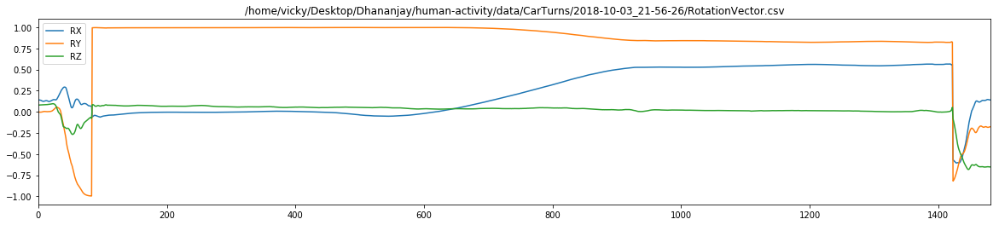

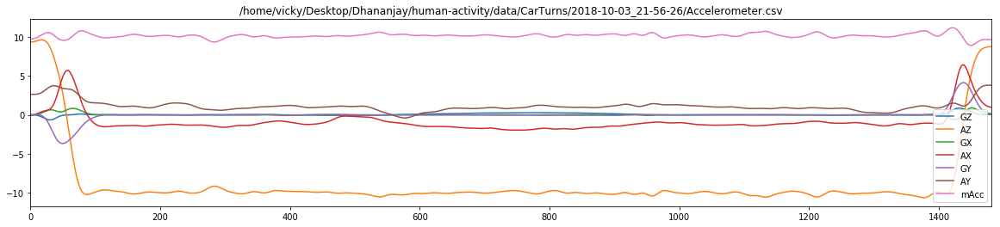

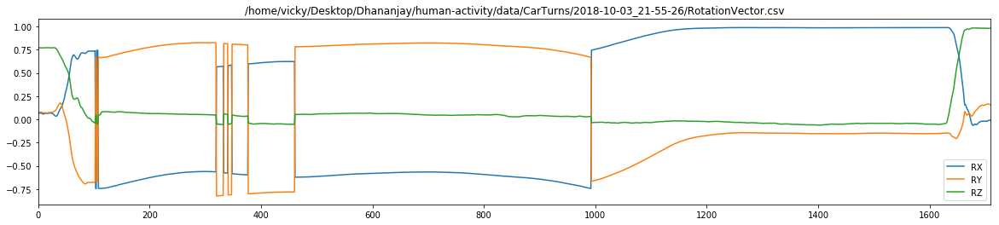

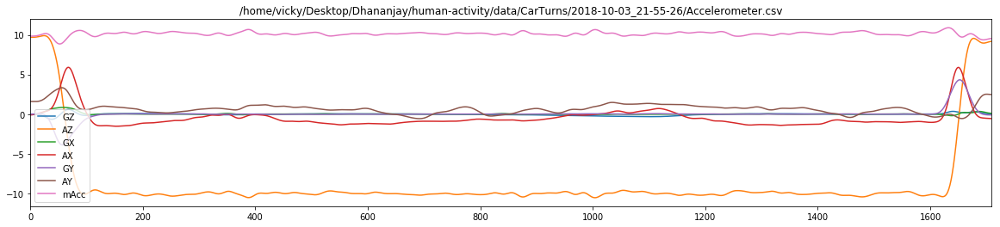

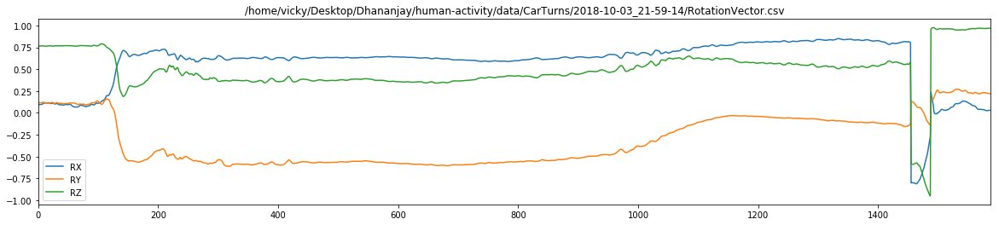

...

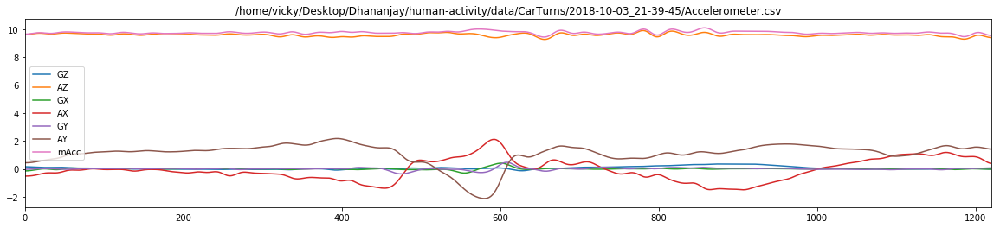

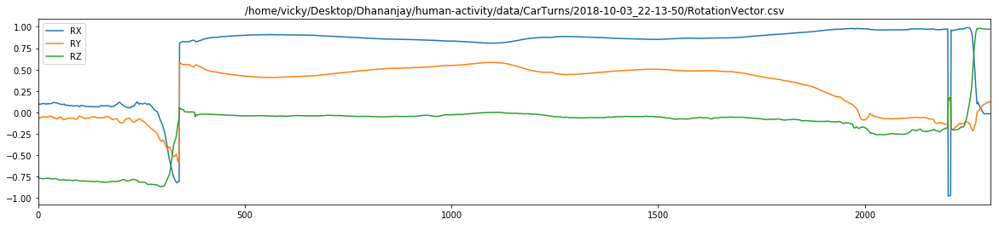

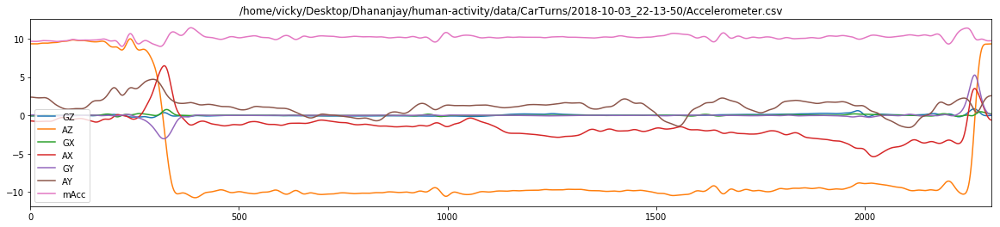

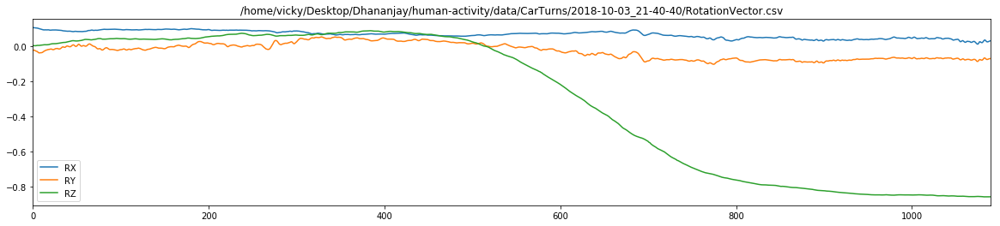

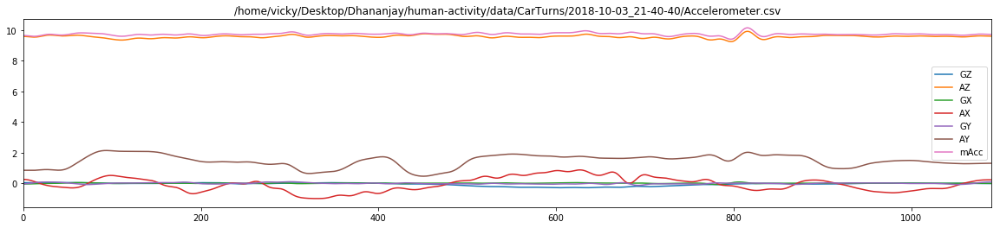

In [140]:
import time
path_acc  = os.getcwd() + '/data/CarTurns/*/*Accelerometer.csv'  
path_gyro = os.getcwd() + '/data/CarTurns/*/*Gyroscope.csv'
path_rot = os.getcwd() + '/data/CarTurns/*/*RotationVector.csv' 
acc_files = glob.glob(path_acc)
gyro_files= glob.glob(path_gyro)
rot_files= glob.glob(path_rot)
bike_df= read_files(acc_files[0], gyro_files[0],rot_files[0], 'bike')
n = len(bike_df)
bike_df = bike_df[200:n-300]
for acc_file, gyro_file, rot_file in zip(acc_files, gyro_files, rot_files) :
#     print(acc_file)
#     print(gyro_file)
    
#     path1 = acc_file.split('/')
#     date_time = path1[9].split('_')
#     key = date_time[1]
#     value = fileVsIntervalRT[key]
#     value_split = value.split('-')

#     l = int(value_split[0])
#     r = int(value_split[1])
    
    df_this = read_files(acc_file, gyro_file,rot_file, 'bike')
    
#     fig, ax = plt.subplots()
#     df_this[['AX','ARY','ARZ']].plot(figsize = (20,4),ax=ax, title = rot_file)
#     n = len(df_this)
    
#     df_this = df_this[l:r]
    fig, ax = plt.subplots()
    df_this[['RX','RY','RZ']].plot(figsize = (20,4),ax=ax, title = rot_file)
    fig, ax = plt.subplots()
    df_this[['GZ','AZ','GX','AX','GY','AY','mAcc']].plot(figsize = (20,4),ax=ax, title = acc_file)
    
    bike_df = pd.concat([bike_df, df_this])
   

bike_df.reset_index(drop = True, inplace = True)
bike_df.head()


In [196]:
print(car_df.shape)
car_df.columns

(49269, 28)


Index(['AX', 'AY', 'AZ', 'GX', 'GY', 'GZ', 'activity', 'mAcc', 'mGyro',
       'orientX', 'orientY', 'orientZ', 'quaternionW', 'quaternionX',
       'quaternionY', 'quaternionZ', 'AX1', 'AY1', 'AZ1', 'GX1', 'GY1', 'GZ1',
       'fAX', 'fAY', 'fAZ', 'fGX', 'fGY', 'fGZ'],
      dtype='object')

In [197]:
car_segments, car_labels = segmentation(car_df, 400)
np.array(car_segments).shape

(978, 11, 400)

In [198]:
car_dtw_data = DTWdistance(car_segments, ref)

calculating loss for feature  0 ....
Done
calculating loss for feature  1 ....
Done
calculating loss for feature  2 ....
Done
calculating loss for feature  3 ....
Done
calculating loss for feature  4 ....
Done
calculating loss for feature  5 ....
Done
calculating loss for feature  6 ....
Done
calculating loss for feature  7 ....
Done
calculating loss for feature  8 ....
Done
calculating loss for feature  9 ....
Done
calculating loss for feature  10 ....
Done


In [199]:
print(np.array(car_dtw_data).shape)
car_dtw_data = [*zip(*car_dtw_data)]
print(np.array(car_dtw_data).shape)

(11, 978)
(978, 11)


In [201]:
import csv
with open("test_data_car.csv","w+") as my_csv:
    csvWriter = csv.writer(my_csv,delimiter=',')
    csvWriter.writerows(car_dtw_data)

In [120]:
train1 = pd.read_csv('test_data_car.csv').values.tolist()
train2 = pd.read_csv('test_data_bike.csv').values.tolist()
train3 = pd.read_csv('train_bike.csv').values.tolist()
train4 = pd.read_csv('train_car.csv').values.tolist()
print(len(train1))
print(len(train2))
print(len(train3))
print(len(train4))


977
1103
1503
1398


In [121]:

label1 = [1]*(len(train1)+len(train4))     #lebel = 1 to all bike samples

label2 = [0]*(len(train2)+len(train3))     #lebel = 0 to all car samples

label = label1 + label2                    #putting both lables into one label

train = train1 + train2 + train3 + train4


In [122]:
len(train)

4981

In [123]:
RANDOM_SEED = 42
X_train, X_test, y_train, y_test = train_test_split(train, label, test_size=0.2, random_state=RANDOM_SEED)

In [124]:
print(len(X_train))
print(len(y_train))
print(len(X_test))
print(len(y_test))


3984
3984
997
997


In [125]:
# apply svm model
print("---------SVM model---------\n")
svm_clf = svm.SVC(kernel='linear', C=1)

# get the 5-fold cross-validation score

---------SVM model---------



In [127]:
print("cross-validation score \n")
scores = cross_val_score(svm_clf, X_train, y_train, cv=5)
print(scores, scores.mean(), scores.std())

# apply model to test set
svm_clf.fit(X_train, y_train)



cross-validation score 

[ 0.77944862  0.82080201  0.81281407  0.79773869  0.80150754] 0.802462185615 0.0141163547325


SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto', kernel='linear',
  max_iter=-1, probability=False, random_state=None, shrinking=True,
  tol=0.001, verbose=False)

In [17]:
# obtain accuracy score
svm_predict_y = svm_clf.predict(X_test)
testscore = accuracy_score(y_test, svm_predict_y)
print("Accuracy score on test set: %6.3f" % testscore)

Accuracy score on test set:  0.809


In [137]:

# train a random forest
print("---------Random-Forest---------\n")
rf_clf = RandomForestClassifier(n_estimators=350)
# get the 5-fold cross-validation score
print("cross-validation score \n")
scores = cross_val_score(rf_clf, X_train, y_train, cv=5)
print(scores, scores.mean(), scores.std())


# apply model to test set
rf_clf.fit(X_train, y_train)


---------Random-Forest---------

cross-validation score 

[ 0.9085213   0.92105263  0.93592965  0.94095477  0.92085427] 0.925462525661 0.011638372736


RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=350, n_jobs=1,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [138]:
rf_predict_y = rf_clf.predict(X_test)

print("\n")
# obtain accuracy score
testscore = accuracy_score(y_test, rf_predict_y)
print("Accuracy score on test set: %6.3f" % testscore)



Accuracy score on test set:  0.932


In [19]:
#make pickle file for SVM model.
list_pickle_path = 'svm_model2.pkl'
# Create an variable to pickle and open it in write mode
list_pickle = open(list_pickle_path, 'wb')
pickle.dump(svm_clf, list_pickle)
list_pickle.close()

In [20]:
#make pickle file for RF model.
list_pickle_path = 'rf_model2.pkl'
# Create an variable to pickle and open it in write mode
list_pickle = open(list_pickle_path, 'wb')
pickle.dump(rf_clf, list_pickle)
list_pickle.close()

In [21]:
pickle_path = 'svm_model2.pkl'
unpickle = open(pickle_path, 'rb')

grd_bst = pickle.load(unpickle)
pred_grd = grd_bst.predict(X_test)
# pred_grd = le.inverse_transform(pred_grd)
accuracy_grd = accuracy_score(pred_grd,y_test)
print('accuracy using svm model1 : ',accuracy_grd)

accuracy using svm model1 :  0.809428284855


In [22]:
pickle_path = 'rf_model2.pkl'
unpickle = open(pickle_path, 'rb')

grd_bst = pickle.load(unpickle)
pred_grd = grd_bst.predict(X_test)
# pred_grd = le.inverse_transform(pred_grd)
accuracy_grd = accuracy_score(pred_grd,y_test)
print('accuracy using svm model1 : ',accuracy_grd)

accuracy using svm model1 :  0.929789368104
